# ECS7020P mini-project Advanced Solution

The mini-project consists of two components:


1.   **Basic solution** [6 marks]: Using the MLEnd Hums and Whistles dataset, build a machine learning pipeline that takes as an input a Potter or a StarWars audio segment and predicts its song label (either Harry or StarWars).
2.   **Advanced solution** [10 marks]: There are two options. (i) Formulate a machine learning problem that can be attempted using the MLEnd Hums and Whistles dataset and build a solution model. (ii) Create a product that uses the functionality provided by a model trained on the MLEnd Hums and Whistles dataset (e.g. a simple App that predicts the label Harry or StarWars when you hum to it).  

The submission will consist of two Jupyter notebooks, one for the basic solution and another one for advanced solution. Please **name each notebook**:

* ECS7020P_miniproject_basic.ipynb
* ECS7020P_miniproject_advanced.ipynb

then **zipped and submitted toghether**.

Each uploaded notebook should consist of: 

*   **Text cells**, describing concisely each step and results.
*   **Code cells**, implementing each step.
*   **Output cells**, i.e. the output from each code cell.

and **should have the structure** indicated below. Notebooks will not be run, please make sure that the output cells are saved.

How will we evaluate your submission?

*   Conciseness in your writing (10%).
*   Correctness in your methodology (30%).
*   Correctness in your analysis and conclusions (30%).
*   Completeness (10%).
*   Originality (10%).
*   Efforts to try something new (10%).

Suggestion: Why don't you use **GitHub** to manage your project? GitHub can be used as a presentation card that showcases what you have done and gives evidence of your data science skills, knowledge and experience. 

Each notebook should be structured into the following 9 sections:


# 1 Author

**Student Name**:  Akansh Katyayan


**Student ID**:  210282553



# 2 Problem formulation

This notebook is for advanced solution on MLEnd Hums and Whistle data. The goal of building this machine learning pipeline is to take all the humming recording for 8 available songs and identify the song for any of the Hum input audio.

*   Potter
*   StarWars
*   Panther
*   Rain
*   Hakuna
*   Mamma
*   Showman
*   Frozen

# 3 Machine Learning pipeline


Machine Learning pipeline is the end-to-end construct that orchestrates the completed process of data into, and output from, a machine learning model. It includes a raw data input, feature engineering, outputs, the machine learning model and model parameters, and prediction outputs.

1. **Data Extraction and Data Cleaning:** MLEnd Hums and Whistle dataset consists of raw audio files which are extracted from the QMUL repository and stored in the private google drive. All 8 songs audio files are used to extract and clean the information about the data. This includes **Data Visualization**(to get an idea of the data) and **Data Sampling** (take samples of data to process instead of working on the whole dataset to optimize time computation)

2. **Feature Engineering:** 
Choose and define the features which our model will use to evaluate the audio  files.
Compute the features for each audio file and build a feature dataframe with the required features.

3. **Model exploration:** Assessment for the models that make sense for the classification dataset

4. **Training the model:** Choose and optimize the properties of our model on validation data - hyperparameters

5. **Evaluate the model's performance:** Evaluate the accuracy of our model on the validation data which is 20% of the training dataset.


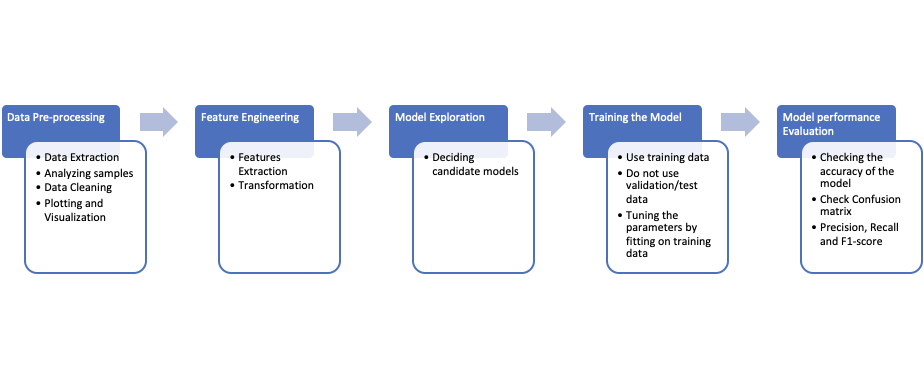

# 4 Transformation stage

**Data pre-processing (Data cleaning and feature engineering)** comprises the most crucial aspect of constructing a machine learning models and often decides the success/failure of the model.Features extraction needs a thorough research on the domain of the problem and accordingly need to use the features to represent the data. For features to be useful in classification they must have high variance between the labelled classes.

MLEnd Hums and Whistle Data consists of raw audio files in a wav format. An audio file can be represented as a time series with the dependent axis being the amplitude of the audio waveform. The waveform of the sound file is all the information we have with which to create features to train our model. There are multiple transformations required to process the audio signals.

Read all the files and extract filename, Participant Id, Interpretation type, Number (song by same user), song title. Filenames are not consistent, so data cleaning is performed on the files data as explained later in the notebook.

**Decomposition**

These audio files are in wav (Waveform Audio File) format which consists of hundreds of thousands of dimensions.  Therefore, relevant features are extracted from the audio signals. Librosa library of python is used to extract the below features: 

**Short-Time Fourier Transform (STFT)**:
we'll use the Short-Time Fourier Transform (STFT) which will cut our audio waveform into short, overlapping equal length segments and take the Fourier transform. Librosa library in python helps to abstract away all the math and fetch most of the details of chromagrams, and MFCC. 

We will build our feature extraction functions to get another two features for each of our audio files.:

  1. **Chromagram**
  2. **MFC coefficients** 
  3. **RMS**: Compute root-mean-square (RMS) value for each frame
  4. **Zero-Crossing Rate**

Because the chromagram and MFCCs are calculated on audio frames produced by STFT, we're going to take a mean of the matrix received from each function and append them in a matrix to represent all the features for each audio in a single dataframe.

**Chromagram**: The term chroma feature or chromagram closely relates to the twelve different pitch classes.

**MFCC**: Mel-frequency cepstral coefficients (MFCCs) are coefficients that collectively represents the power spectrum of an audio signal in a frequency region (a region of pitch) taken w.r.t. time.
We are using 40 number of coefficients to return at n_mfcc=40 which worked well compared to 20 coefficients.

**RMS**

Compute root-mean-square (RMS) value for each frame from the audio signals

**Zero-Crossing Rate**

A very simple way for measuring the smoothness of a signal is to calculate the number of zero-crossing within a segment of that signal. A voice signal oscillates slowly — for example, a 100 Hz signal will cross zero 100 per second — whereas an unvoiced fricative can have 3000 zero crossings per second.



**Scaling**:
Data may have numeric attributes that varies in different ranges. Scaling is about normalizing these attributes so that they will have the same scale, such as between 0 and 1.


# 5 Modelling

As the problem statement is to classify the audio files into different songs based on the audio signal features. We will first select some of the classic Machine learning classification models like **Support Vector Machines classifier(SVC)**, **k-Nearest-Neighbout clasifier(kNN)**, **Decision Trees**, **Random Forest Classifier**, **Gaussian Naive Bayes**, etc.

Top 3 classifiers with the overall accuracy from the above classifiers will be selected and analyzed in detail.

We will also explore the Artificial Neural Network (ANN) well-suited for predictions trained on labelled inputs. We will be building a MLPClassfier and train it on the training data and evaluate using the validation data. MLPClassifier is also tuned using the GridSearchCV  to get the best parameters value and analyze the performance of the model on validation data for those parameters.

We will also analyze the performance of **Convolutional neural networks**, also called ConvNets for Audio classification. 


Also, data needs to be scaled before using it to train the model because different features have different range of values and thus model can give more weight to the features with higher range. Sklearn library's StandardScaler is used for features with unknown distributions because centering the features at zero-mean with a standard deviation of 1 means extreme values will have less of an impact on the model's learned weights, so that the model is less sensitive to the outliers.

To process these functions, sklearn library's machine learning pipeline is used which automates the above steps and calculates the accuracy of the models on the validation data to assess the performance of the model.


# 6 Methodology


The goal of this step is to develop the simplest model able to formulate a target value fast and well enough. More accurately, the proper approach for training and evaluating a model is :

Train the selected model on a training set.

Evaluate the model on a validation set (unseen data for the model)

Hyperparamters tuning to identify the best parameters for the selected model on the training data and evaluate again on Validation data.

Finally train the model with the best parameters and test the accuracy of the model.

**Note**: Do not tune the model to score well on the test set.

Evaluation Measures:

**Confusion Matrix:**
A Confusion matrix is an N x N matrix used for evaluating the performance of a classification model, where N is the number of target classes, here N=8. So, it will give us 8 X 8 matrix with True Positive, True Negative, False Positive and False Negative values for the classification.

**Precision, Recall, F-Score**
The confusion matrix is an intuitive measure of the precision and recall of our model with respect to each class. 

**Precision** is a measure of how many positive predictions are true positives and is calculated as:

Precision = TruePositives / (TruePositives + FalsePositives)

**Recall** is a measure of how many positives we actually predicted from all positive samples in the dataset and is calculated as:

Recall = TruePositives / (TruePositivves + FalseNegatives)

Lower precision means we have more false positives, while lower recall means we have more false negatives. 

For this dataset, *precision of each song is how often we correctly predict it and recall is how many of that song we predicted out of all samples with that song in the dataset*.

**The F-score** is a weighted average of precision and recall when we are equally concerned with both the metrics.

F-score = (2 * Precision * Recall) / (Precision + Recall)

In our approach we are checking these measures to assess the overall performance of the model and its accuracy.

# 7 Dataset

Information of the Dataset:

1. **Title**: MLEnd Hums and Whistle Dataset

2. Sources:
   (a) **Origin**:  This dataset has been taken from the MLEnd Hums and Whistle data collected and maintained at Queen Mary University of London.
   (b) **Creator**:  Dr. Requena-Carrion and MSc. Big Data Science batch of 2021-2022
   (c) **Date**: Nov 8, 2021

3. Relevant Information:
   Concerns Hums and Whistle recording of ~15 seconds for below 8 songs.
   1. Potter
   2. StarWars
   3. Panther
   4. Rain
   5. Hakuna
   6. Mamma
   7. Showman
   8. Frozen

4. Total number of songs: 2342:

    Showman     299 <br/>
    Panther     297 <br/>
    StarWars    297 <br/>
    Hakuna      293 <br/>
    Rain        291 <br/>
    Frozen      290 <br/>
    Mamma       288 <br/>
    Potter      287 </br>

6. Attribute Information:
    Information which can be fetched from the filenames
    1. Participant ID:          Id of the participant who hummed the song
    2. Interpretation:         Category - hum 
    3. Number:                 hum sample by each participant
    4. Song:                   song out of above 8 songs


## Import required libraries/packages for the project



In [2]:
from google.colab import drive

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import os, sys, re, pickle, glob
import urllib.request
import zipfile

import IPython.display as ipd
from tqdm import tqdm
import librosa

import soundfile
!pip install pydub
from pydub import AudioSegment

drive.mount('/content/drive')

Mounted at /content/drive


## 7.1 Download and Extract data from the repository:

Data submitted by all the students is stored on the queen mary repository. Below function will download the data by using the provided URLs as listed below. Downloaded files are in compressed in a zip format and thus need to be unzipped before use. Python zipfile package is used to unzip the files in a single folder - AdvancedSongs. This step can also be referred as **Data Integration** as we are integrating data from various sources/files to a single location.

**Potter**

Part 1: https://collect.qmul.ac.uk/down?t=6PF2H2T4GP4I1LPK/45OGPQAA1S6E5AEAA2RLEU0

Part 2: https://collect.qmul.ac.uk/down?t=4H6293T0GAQLO4RG/55TMAI1BTPMG7I1A71923EO

**StarWars**

Part 1: https://collect.qmul.ac.uk/down?t=45PGP4DEJH9JLV8U/4H7ITD5VEBGREV4UGNI8SAO

Part 2: https://collect.qmul.ac.uk/down?t=652DPSGDVKPDJ7NV/6PF3DFT4AN3AOPS5JJS9KFG

**Panther**

Part 1: https://collect.qmul.ac.uk/down?t=6PEJ3F3JAUC7UC2D/4L7DHN27184UV966BQVL6T0

Part 2: https://collect.qmul.ac.uk/down?t=59U0J4LDJL93JVGV/6P63FB5NFBSPUL5MLR5AE30

**Rain**

Part 1: https://collect.qmul.ac.uk/down?t=517I33T0GAQLO4RG/515I53KL8GRTR5NKDM4M0H0

Part 2: https://collect.qmul.ac.uk/down?t=5532TCQC7ROPGNTS/593IPD5VEBGREV4UG2F4QQ8

**Hakuna**

Part 1: https://collect.qmul.ac.uk/down?t=R8RSMAE6KHLG5DEM/55VMAJEMJEC7SDANP4NSFQ0

Part 2: https://collect.qmul.ac.uk/down?t=595ID3D2G2RLS4BI/595IH27BLQMK623AUKAFLNG

**Mamma**

Part 1: https://collect.qmul.ac.uk/down?t=556J7CAE7JPPKNDU/4TSGN54VAB0LE73US43UBJ8

Part 2: https://collect.qmul.ac.uk/down?t=6P4IFDQ87BUP8MTO/5DT0PQ2B1O6U7A6AAQRLASO

**Showman**

Part 1: https://collect.qmul.ac.uk/down?t=4H72D3D2G2RLS4BI/61937ETOF7T90MTPKN0QG08

Part 2: https://collect.qmul.ac.uk/down?t=R8RCRL3BBU86EA25/4HUGH6CQBVEB4UCRGVM828G

**Frozen**

Part 1: https://collect.qmul.ac.uk/down?t=4H62B2T4GP4I1LPK/593THN27184UV966BEPLGV8

Part 2: https://collect.qmul.ac.uk/down?t=45U68V5JITC3VS0D/450TVH5FCB8QER4EIFQ9KEG

In [3]:
"""
Function to download the data from the given URL
"""
def download_url(url, save_path):
    with urllib.request.urlopen(url) as dl_file:
      filename = dl_file.geturl().split('/')[-1]
      savefile = save_path + filename
      print("File: {} to be saved at the location: {}".format(filename, savefile))
      with open(savefile, 'wb') as out_file:
        out_file.write(dl_file.read())

"""
Define URLs and download the data and save directory
"""
save_path = '/content/drive/MyDrive/Data/MLEndHW/'
list_url = ["https://collect.qmul.ac.uk/down?t=6PF2H2T4GP4I1LPK/45OGPQAA1S6E5AEAA2RLEU0",
            "https://collect.qmul.ac.uk/down?t=4H6293T0GAQLO4RG/55TMAI1BTPMG7I1A71923EO",
            "https://collect.qmul.ac.uk/down?t=45PGP4DEJH9JLV8U/4H7ITD5VEBGREV4UGNI8SAO",
            "https://collect.qmul.ac.uk/down?t=652DPSGDVKPDJ7NV/6PF3DFT4AN3AOPS5JJS9KFG",
            "https://collect.qmul.ac.uk/down?t=6PEJ3F3JAUC7UC2D/4L7DHN27184UV966BQVL6T0",
            "https://collect.qmul.ac.uk/down?t=59U0J4LDJL93JVGV/6P63FB5NFBSPUL5MLR5AE30",
            "https://collect.qmul.ac.uk/down?t=517I33T0GAQLO4RG/515I53KL8GRTR5NKDM4M0H0",
            "https://collect.qmul.ac.uk/down?t=5532TCQC7ROPGNTS/593IPD5VEBGREV4UG2F4QQ8",
            "https://collect.qmul.ac.uk/down?t=R8RSMAE6KHLG5DEM/55VMAJEMJEC7SDANP4NSFQ0",
            "https://collect.qmul.ac.uk/down?t=595ID3D2G2RLS4BI/595IH27BLQMK623AUKAFLNG",
            "https://collect.qmul.ac.uk/down?t=556J7CAE7JPPKNDU/4TSGN54VAB0LE73US43UBJ8",
            "https://collect.qmul.ac.uk/down?t=6P4IFDQ87BUP8MTO/5DT0PQ2B1O6U7A6AAQRLASO",
            "https://collect.qmul.ac.uk/down?t=4H72D3D2G2RLS4BI/61937ETOF7T90MTPKN0QG08",
            "https://collect.qmul.ac.uk/down?t=R8RCRL3BBU86EA25/4HUGH6CQBVEB4UCRGVM828G",
            "https://collect.qmul.ac.uk/down?t=4H62B2T4GP4I1LPK/593THN27184UV966BEPLGV8",
            "https://collect.qmul.ac.uk/down?t=45U68V5JITC3VS0D/450TVH5FCB8QER4EIFQ9KEG"
          ]

"""
Code to execute download function using URLs. Commented as files are already saved on the drive.
"""
# for url in list_url:  
#   download_url(url, save_path)

"""
Code to unzip files into AdvancedSongs folder on my drive. Commented as files are unzipped and need not to be unzipped everytime.
"""
# directory_to_extract_to = '/content/drive/MyDrive/Data/MLEndHW/AdvancedSongs/'
# for path in tqdm(os.listdir(save_path)):
#   full_path = os.path.join(save_path, path)
#   if os.path.isfile(full_path) and path.endswith(".zip") and path != "MLEndHW_Sample.zip":
#     print("Unzipping File: {}".format(path))
#     try:
#       with zipfile.ZipFile(full_path, 'r') as zip_ref:
#         zip_ref.extractall(directory_to_extract_to)
#     except Exception as e:
#       print("Error in unzipping file: {}. Error: {}".format(path, str(e)))
#     finally:
#       zip_ref.close()

"""
Read all the .wav files from AdvancedSongs folder
"""
sample_path = '/content/drive/MyDrive/Data/MLEndHW/AdvancedSongs/*.wav'
files = glob.glob(sample_path)
print("Total files in Songs folder: {}".format(len(files)))

Total files in Songs folder: 3294


## 7.2 Data Pre-processing:
Data pre-processing is an important step in the machine learning workflow. pre-processing is required for the given raw audio data to understand it better. All the unzipped audio files are read and cleaned as below:

**Data cleaning**
Each audio file in the data is supposed to follow the below naming convention.
participantid_interpretationtype_number_songname.wav
eg: S1_hum_1_Potter.wav
    S2_whistle_2_Rain.wav

Songs which do not follow the naming convention as above have been discarded using an exception handling in python.

Songs are mis-spelled in the filenames, thus spelling correction is done to record the correct name for each song. 

Unnecessary special symbols have been removed from the filenames.

Lastly, data is recorded in a dataframe which contains information for each song.
 




In [4]:
songs_detail = [] 
discarded_songs = []
songs_in_scope = ["Potter", "StarWars", "Panther", "Rain", "Hakuna", "Mamma", "Showman", "Frozen"]


# Lists of words spelt incorrectly in the file names for Hums and Whistle data.
hums_values = ["hum", "hun", "ham"]
whistles_values = ["whistle", "whisle", "whislte", "wistle"]
potter_titles = ["potter"]
rain_titles = ["rain", "therain"]
frozen_titles = ["frozen", "letitgo"]
hakuna_titles = ["hakuna", "hakana", "haknua", "hukuna"]
mamma_titles = ["mamma", "mamia", "mama", "mummamia", "mumma"]
showman_titles = ["showman", "snowman", "this_is_me", "thisisme"]
panther_titles = ["panther", "pinkpanther", "pink_panther", "panter"]
sw_titles = ["starwars", "starwar", "starswars", "statwars", "startwars", "star_wars", "imperial"]


# Function to read files, clean the data for errors in the names and create a dataframe
def perform_data_cleaning(input_files):
  # Loop over all the audio files
  for file in input_files:
    try:
      file_name = os.path.basename(file)
      participant_ID = file_name.split('_')[0]    

      # Handle Interpretation type for unstructured filenames 
      if file_name.split('_')[1].lower() not in ['hum', 'whistle']:
        if any(hums_value in file_name.lower() for hums_value in hums_values):
          interpretation_type = "hum"
        elif any(wishtle_value in file_name.lower() for wishtle_value in whistles_values):
          interpretation_type = "whistle"
        else:
          discarded_songs.append(file_name)
          continue
      else:
        interpretation_type = file_name.split('_')[1].lower()
      
      interpretation_number = file_name.split('_')[2]

      # Handle Song Title
      song_title_check = file_name.split('_')[3].split('.')[0]
      if song_title_check not in songs_in_scope:
        correct_file_name = file_name.rsplit('.')[0]
        # Remove unnecessary characters from the name
        for char in ["[", "]", " ", ".wav", "wav", ""]:
          correct_file_name = correct_file_name.replace(char, "")
        if any(potter_title in correct_file_name.lower() for potter_title in potter_titles):
          song = "Potter"
        elif any(sw_title in correct_file_name.lower() for sw_title in sw_titles):
          song = "StarWars"
        elif any(panther_title in correct_file_name.lower() for panther_title in panther_titles):
          song = "Panther"
        elif any(rain_title in correct_file_name.lower() for rain_title in rain_titles):
          song = "Rain"
        elif any(hakuna_title in correct_file_name.lower() for hakuna_title in hakuna_titles):
          song = "Hakuna"
        elif any(mamma_title in correct_file_name.lower() for mamma_title in mamma_titles):
          song = "Mamma"
        elif any(showman_title in correct_file_name.lower() for showman_title in showman_titles):
          song = "Showman"
        elif any(frozen_title in correct_file_name.lower() for frozen_title in frozen_titles):
          song = "Frozen"
        else:
          discarded_songs.append(file_name)
          continue
      else:
        song = song_title_check
      
      songs_detail.append([file_name,participant_ID,interpretation_type,interpretation_number, song, file])
    except Exception as e:
      #print("Error in extracting info from file {}. Error: {}".format(file, str(e)))
      discarded_songs.append(file_name)

  df_songs = pd.DataFrame(songs_detail,columns=['file_id','participant','interpretation','number','song', 'file_path']).set_index('file_id') 
  print("Songs: {}".format(df_songs['song'].unique()))
  print("Total Discarded Files: {} : {}".format(len(discarded_songs), discarded_songs))
  return df_songs


### Read all the songs and extract only Hums

In [5]:
df_all_songs = perform_data_cleaning(files)
df_all_songs.drop_duplicates(inplace=True)
print("Total number of songs: {}".format(df_all_songs.shape[0]))
print("Details of Number of each song:\n{}".format(df_all_songs['song'].value_counts()))

df_hum_songs = df_all_songs[df_all_songs['interpretation'] == "hum"]
print("Total number of Hum songs: {}".format(df_hum_songs.shape[0]))
print("Details of Number of hummings for each song:\n{}".format(df_hum_songs['song'].value_counts()))
display(df_hum_songs)


# Samples were taken to analyze the models to optimize the time computation while building the models.
# df_sample = df_hum_songs.sample(n=500, replace=False)
# display(df_sample)

Songs: ['Frozen' 'Potter' 'StarWars' 'Mamma' 'Showman' 'Panther' 'Rain' 'Hakuna']
Total Discarded Files: 28 : ['S95_Hum 2 Potter.wav', 'S95_Whistle 2 Potter.wav', 'S42_Hum2_StarWar.wav', 'S42_Hum3.StarWar.wav', 'S95_Hum 1 StarWars.wav', 'S95_Whistle 1 StarWars.wav', 'S42_Hum1_Mamma.wav', 'S42_Hum2_Mamma.wav', 'S95_Hum 1 Mamma.wav', 'S95_Whistle 1 Mamma.wav', 'S42_Hum3_Showman.wav', 'S42_Hum4_Showman.wav', 'S95_Hum 1 Showman.wav', 'S95_Whistle 2 Showman.wav', 'S42_Hum3_Frozen.wav', 'S42_Hum4_Frozen.wav', 'S95_Hum 2 Frozen.wav', 'S95_Whistle 2 Frozen.wav', 'S42_Hum2_The Rain.wav.wav', 'S95_Hum 1 Rain.wav', 'S95_Whistle 2 Rain.wav', 'S42_Hum1_Hakuna.wav', 'S42_Hum3_Hakuna.wav', 'S95_Hum 2 Hakuna.wav', 'S95_Whistle 2 Hakuna.wav', 'S42_Hum3_Pink Panther.wav.wav', 'S95_Hum 2 Panther.wav', 'S95_Whistle 1 Panther.wav']
Total number of songs: 3266
Details of Number of each song:
Panther     410
Rain        410
Potter      409
StarWars    409
Mamma       408
Hakuna      408
Frozen      406
Showm

,participant,interpretation,number,song,file_path
file_id,,,,,
S136_hum_2_Frozen.wav,S136,hum,2,Frozen,/content/drive/MyDrive/Data/MLEndHW/AdvancedSo...
S136_hum_4_Frozen.wav,S136,hum,4,Frozen,/content/drive/MyDrive/Data/MLEndHW/AdvancedSo...
S137_hum_2_Frozen.wav,S137,hum,2,Frozen,/content/drive/MyDrive/Data/MLEndHW/AdvancedSo...
S137_hum_4_Frozen.wav,S137,hum,4,Frozen,/content/drive/MyDrive/Data/MLEndHW/AdvancedSo...
S138_hum_2_Frozen.wav,S138,hum,2,Frozen,/content/drive/MyDrive/Data/MLEndHW/AdvancedSo...
...,...,...,...,...,...
S172_hum_2_Panther.wav,S172,hum,2,Panther,/content/drive/MyDrive/Data/MLEndHW/AdvancedSo...
S173_hum_2_Panther.wav,S173,hum,2,Panther,/content/drive/MyDrive/Data/MLEndHW/AdvancedSo...
S174_hum_2_Panther.wav,S174,hum,2,Panther,/content/drive/MyDrive/Data/MLEndHW/AdvancedSo...


## 7.3 Data Analysis and Visualization
Let's compare the waveforms for all the songs for both Hums and Whistle data.

###Plotting Waveforms and Spectograms for samples

In [6]:
# Take two samples of all the songs
potter_hum = df_hum_songs[df_hum_songs['song'] == "Potter"]["file_path"][0]

starwars_hum = df_hum_songs[df_hum_songs['song'] == "StarWars"]["file_path"][0]

panther_hum = df_hum_songs[df_hum_songs['song'] == "Panther"]["file_path"][0]

rain_hum = df_hum_songs[df_hum_songs['song'] == "Rain"]["file_path"][0]

hakuna_hum = df_hum_songs[df_hum_songs['song'] == "Hakuna"]["file_path"][0]

mamma_hum = df_hum_songs[df_hum_songs['song'] == "Mamma"]["file_path"][0]

showman_hum = df_hum_songs[df_hum_songs['song'] == "Showman"]["file_path"][0]

frozen_hum = df_hum_songs[df_hum_songs['song'] == "Frozen"]["file_path"][7]


/content/drive/MyDrive/Data/MLEndHW/AdvancedSongs/S1_hum_2_Potter.wav


/content/drive/MyDrive/Data/MLEndHW/AdvancedSongs/S1_hum_2_StarWars.wav


/content/drive/MyDrive/Data/MLEndHW/AdvancedSongs/S177_hum_2_Panther.wav


/content/drive/MyDrive/Data/MLEndHW/AdvancedSongs/S1_hum_1_Rain.wav


/content/drive/MyDrive/Data/MLEndHW/AdvancedSongs/S1_hum_2_Hakuna.wav


/content/drive/MyDrive/Data/MLEndHW/AdvancedSongs/S161_hum_2_Mamma.wav


/content/drive/MyDrive/Data/MLEndHW/AdvancedSongs/S1_hum_1_Showman.wav


/content/drive/MyDrive/Data/MLEndHW/AdvancedSongs/S142_hum_2_Frozen.wav


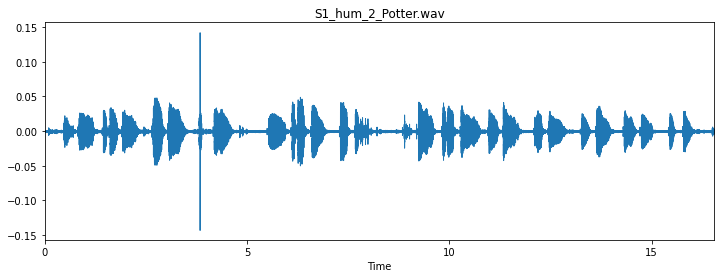

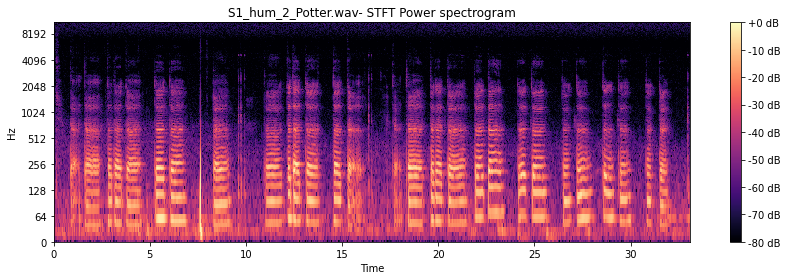

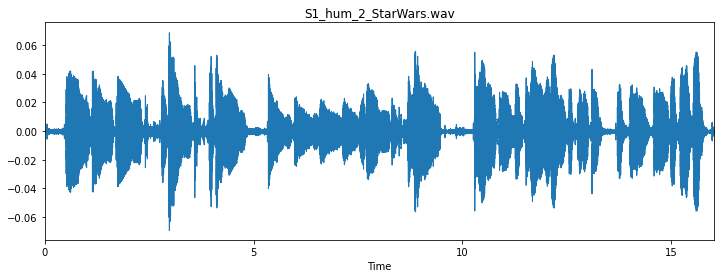

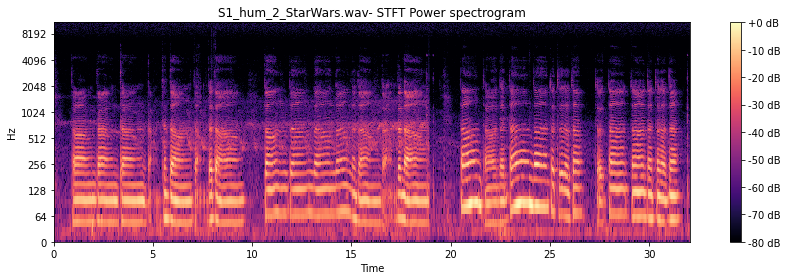

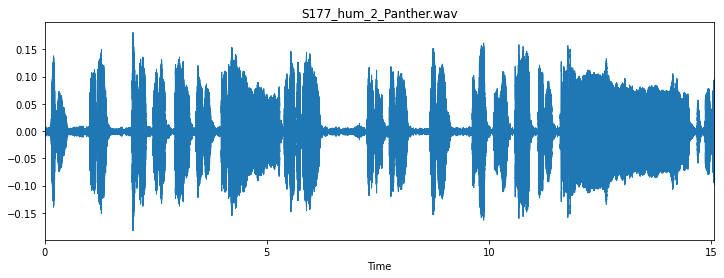

...

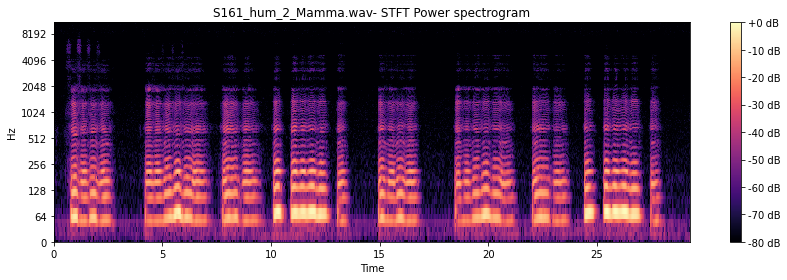

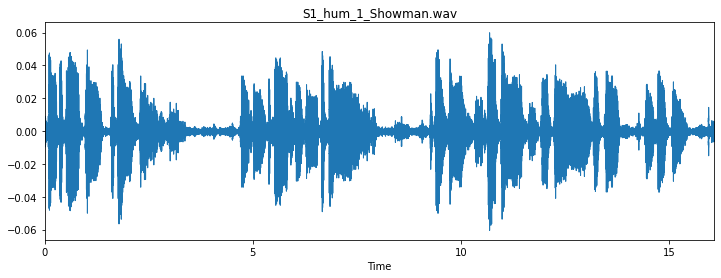

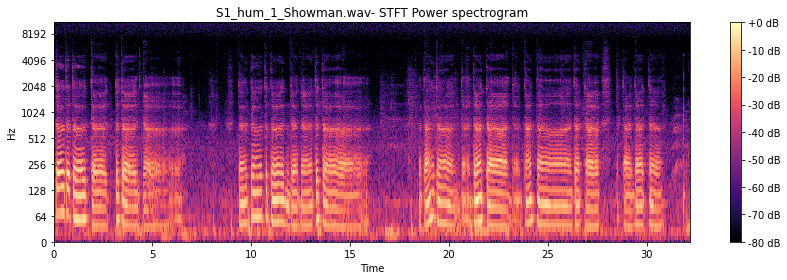

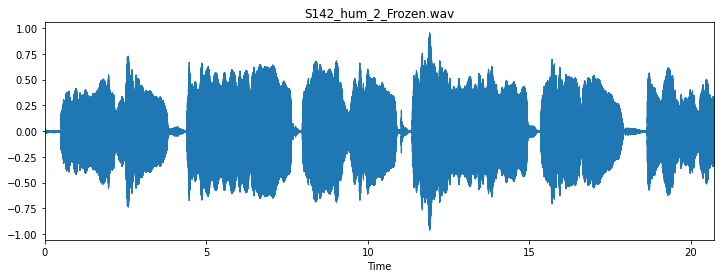

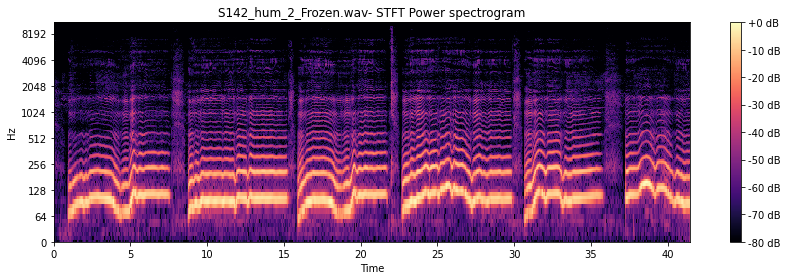

In [7]:
# Suppress warning for plotting more than 20 plots together
import librosa.display
plt.rcParams['figure.max_open_warning'] = 0

#list of samples extracted for each kind
song_samples = [potter_hum, starwars_hum, panther_hum, rain_hum,hakuna_hum, mamma_hum, showman_hum, frozen_hum]

#Loop over each song to plot audio signal and STFT spectrogram to check the differences.
for song_type in song_samples:
  print(song_type)
  display(ipd.Audio(song_type))
  with soundfile.SoundFile(song_type) as audio:
    waveform = audio.read(dtype="float32")
    sample_rate = audio.samplerate
    plt.figure(figsize=(12,4))
    librosa.display.waveplot(waveform, sr=sample_rate)
    plt.title(os.path.basename(song_type))

    stft_spectrum_matrix = librosa.stft(waveform)
    plt.figure(figsize=(12,4))
    librosa.display.specshow(librosa.amplitude_to_db(np.abs(stft_spectrum_matrix), ref=np.max),y_axis='log', x_axis='time')
    plt.title(os.path.basename(song_type) + '- STFT Power spectrogram')
    plt.colorbar(format='%+2.0f dB')
    plt.tight_layout()


Alright, we can see a visible difference in the raw waveforms - we cannot use them to classify the song. We need to decompose these audio signals to to identify the frequency within a time interval for each audio.






###Plotting MFCC

Positive MFCCs correspond to low-frequency regions of the cepstrum, and negative MFFCs to high-frequency.

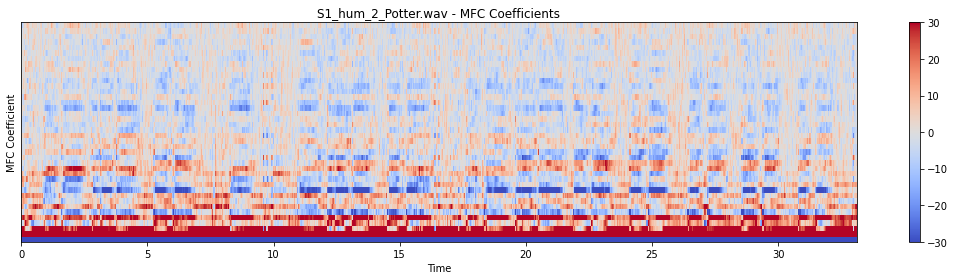

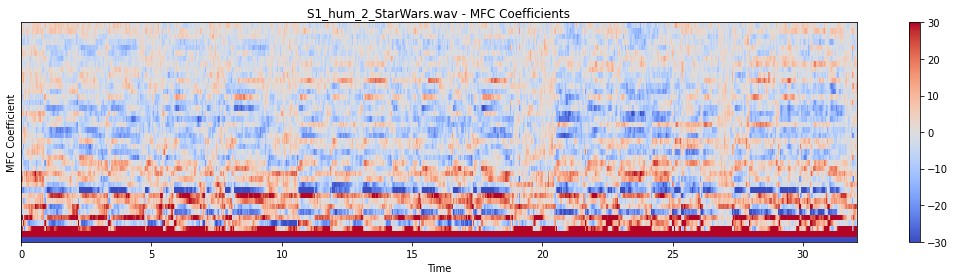

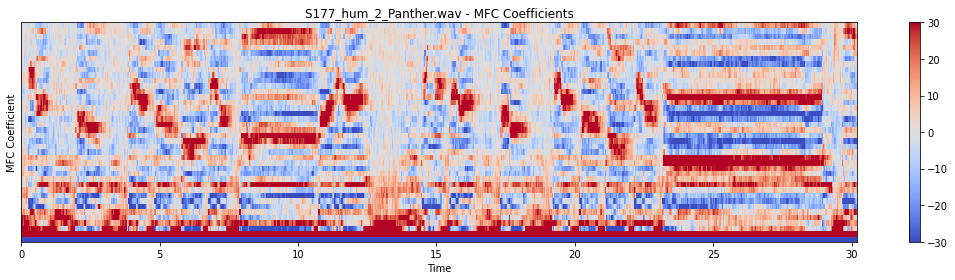

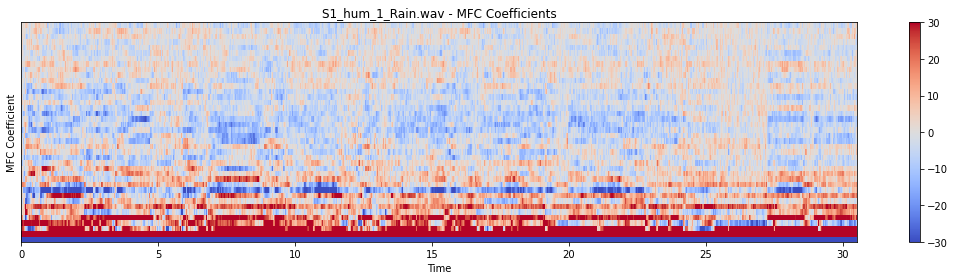

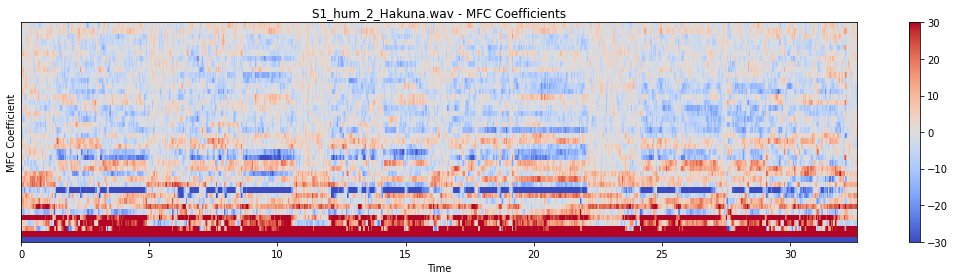

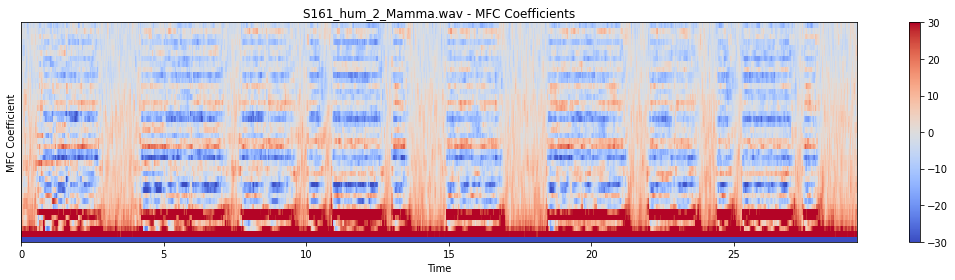

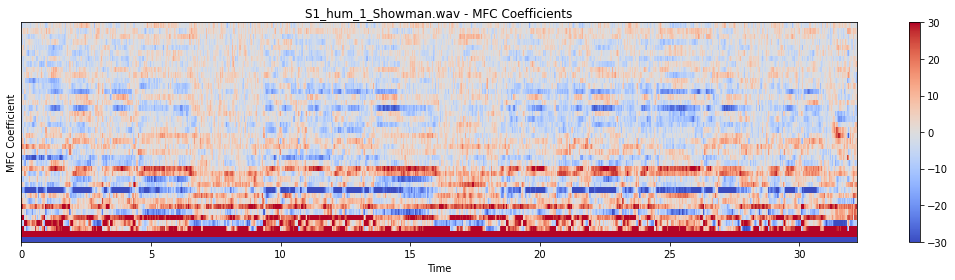

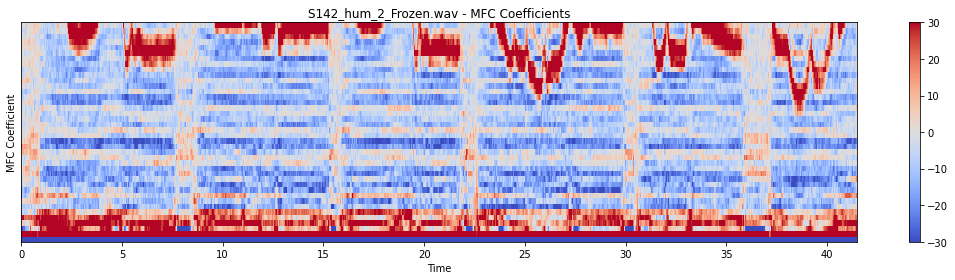

In [8]:
from matplotlib.colors import Normalize

song_samples = [potter_hum, starwars_hum, panther_hum, rain_hum,hakuna_hum, mamma_hum, showman_hum, frozen_hum]

#Loop over each song to plot audio signal and MFCC to check the differences.
for song_type in song_samples:
  with soundfile.SoundFile(song_type) as audio:
      song_waveform = audio.read(dtype="float32")
      sample_rate = audio.samplerate
      mfc_coefficients = librosa.feature.mfcc(y=song_waveform, sr=sample_rate, n_mfcc=40)
      plt.figure(figsize=(15, 4))
      librosa.display.specshow(mfc_coefficients, x_axis='time',norm=Normalize(vmin=-30,vmax=30))
      plt.colorbar()
      plt.yticks(())
      plt.ylabel('MFC Coefficient')
      plt.title(os.path.basename(song_type) + ' - MFC Coefficients')
      plt.tight_layout()

On analyzing MFCC plots, we can see the most of the songs lie in the negative frequency region whereas Panther, Frozen and Showman have high frequency regions. This can help in identifying these songs using MFCC features.

Also, we can observed that some of the songs have no waveform in the initial second of the audio. Therefore, we can try to trim the initial and end 1 second of the audio. Same will be applied to all the songs while extracting features.

In [9]:
# Code to test the removal of 1 sec of audio from the beginning on a random sample.

from pydub import AudioSegment

n = np.random.randint(len(files))
song = AudioSegment.from_wav(files[n])
print("Audio File: {}".format(os.path.basename(files[n])))
display(song)

#Remove 1 seconds from start
one_seconds = 1 * 1000 
song_new = song[one_seconds:]
print("Removed 1st second") 
display(song_new)

Audio File: S61_whistle_1_[Mama].wav


Removed 1st second


## 7.4 Feature Engineering

Musical signals are highly non-stationary. So, instead of computing a single Fourier transform for an entire audio, the short-time Fourier transform (STFT) is used by computing the Fourier transform for successive frames in a signal.

Below features have been extracted and machine learning pipeline has been tested on these features:

**Mel-Frequency Cepstral Coefficients (MFCC)**
We have extracted more features from STFT using MFCC. MFCC is a mathematical method which transforms the power spectrum of an audio signal to a small number of coefficients representing power of the audio signal in a frequency region (a region of pitch) against time. We can read more about MFCC - here

On experimentation, 40 coefficients provided the best accuracy and thus selected n_mfcc=40.

**Chromogram**
To extract an additional feature, we are using chromagram on each power spectrogram computed by STFT. A chromagram represents an audio signal w.r.t. time, mapping audio signal to a pitch class. Most often, we map to the 12 standard pitch classes. More details about Chromogram are available here

**RMS**

Compute root-mean-square (RMS) value for each frame from the audio signals

**Zero-Crossing Rate**

A very simple way for measuring the smoothness of a signal is to calculate the number of zero-crossing within a segment of that signal. A voice signal oscillates slowly — for example, a 100 Hz signal will cross zero 100 per second — whereas an unvoiced fricative can have 3000 zero crossings per second.


**Spectral Bandwidth**

The spectral bandwidth is defined as the width of the band of light at one-half the peak maximum (or full width at half maximum [FWHM]) and is represented by the two vertical red lines and λSB on the wavelength axis.

**Spectral Rolloff**

It is a measure of the shape of the signal. It represents the frequency at which high frequencies decline to 0. To obtain it, we have to calculate the fraction of bins in the power spectrum where 85% of its power is at lower frequencies.

**Spectral Centroid**

The spectral centroid indicates at which frequency the energy of a spectrum is centered upon or in other words It indicates where the ” center of mass” for a sound is located. This is like a weighted mean

In [10]:
def feature_chromagram(waveform, sample_rate):
    # STFT computed here explicitly; mel spectrogram and MFCC functions do this under the hood
    stft_spectrogram=np.abs(librosa.stft(waveform, hop_length = 512, n_fft = 2048))
    # Produce the chromagram for all STFT frames and get the mean of each column of the resulting matrix to create a feature array
    chromagram=np.mean(librosa.feature.chroma_stft(S=stft_spectrogram, sr=sample_rate).T,axis=0)
    return chromagram

def feature_melspectrogram(waveform, sample_rate):
    # Produce the mel spectrogram for all STFT frames and get the mean of each column of the resulting matrix to create a feature array
    # Using 8khz as upper frequency bound should be enough for most speech classification tasks
    melspectrogram=np.mean(librosa.feature.melspectrogram(y=waveform, sr=sample_rate).T,axis=0)
    return melspectrogram

def feature_mfcc(waveform, sample_rate):
    # Compute the MFCCs for all STFT frames and get the mean of each column of the resulting matrix to create a feature array
    # 40 filterbanks = 40 coefficients
    mfc_coefficients=np.mean(librosa.feature.mfcc(y=waveform, sr=sample_rate, n_mfcc=40).T, axis=0) 
    return mfc_coefficients

def feature_zcr(waveform):
  #compute zcr, Zero crossing rate which determines the rate at which signal crosses zero while moving from +ve to -ve or vice versa
  zcr_coefficients = np.mean(librosa.feature.zero_crossing_rate(y=waveform).T, axis = 0)
  return zcr_coefficients

def feature_spectral_bandwidth(waveform, sample_rate):
  sb_coefficients = np.mean(librosa.feature.spectral_bandwidth(y=waveform, sr=sample_rate).T, axis=0)
  return sb_coefficients

def feature_spectral_centroid(waveform, sample_rate):
  sc_coefficients = np.mean(librosa.feature.spectral_centroid(y=waveform, sr=sample_rate).T, axis=0)
  return sc_coefficients

def feature_rms(waveform):
  rms_coefficients = np.mean(librosa.feature.rms(y=waveform).T, axis=0)
  return rms_coefficients

def feature_rolloff(waveform, sample_rate):
  rolloff_coefficients = np.mean(librosa.feature.spectral_rolloff(y=waveform, sr=sample_rate).T, axis=0)
  return rolloff_coefficients


In [11]:
def get_features(file):
    # load an individual soundfile
     with soundfile.SoundFile(file) as audio:
        
        fs = None # if None, fs would be 22050
        x, fs = librosa.load(file,sr=fs)
        
        waveform = audio.read(dtype="float32")
        sample_rate = audio.samplerate
        # compute features of soundfile
        chromagram = feature_chromagram(x, fs)
        # melspectrogram = feature_melspectrogram(waveform, sample_rate)
        rms_coefficients = feature_rms(x)
        # rolloff_coefficients = feature_rolloff(x, fs)
        zcr_coefficients = feature_zcr(x)
        # sb_coefficients = feature_spectral_bandwidth(x, fs)
        # sc_coefficients = feature_spectral_centroid(x, fs)
        mfc_coefficients = feature_mfcc(x, fs)

        feature_matrix=np.array([])
        # use np.hstack to stack our feature arrays horizontally to create a feature matrix
        #feature_matrix = np.hstack((power, pitch_mean, pitch_std, voiced_fr, mfc_coefficients)
        #feature_matrix = np.hstack((rms_coefficients, rolloff_coefficients, sc_coefficients, mfc_coefficients))
        #feature_matrix = np.hstack((rms_coefficients, mfc_coefficients))
        feature_matrix = np.hstack((rms_coefficients, zcr_coefficients, chromagram, mfc_coefficients))
        
        return feature_matrix

During feature extraction using soundFile, Some of the files of the same song have Mono channel whereas others have Sterio channel. Therefore, changing the channel to mono for sterio files before processing through a librosa function.For changing the channel AudioSegment function of pydub library is used as below:

In [12]:
def load_data(input_data):
    X,y=[],[]
    mono_files_path = "/content/drive/MyDrive/Data/MLEndHW/Mono/"
    for file in tqdm(input_data["file_path"]):
        file_name=os.path.basename(file)
        song_title=str(input_data.loc[file_name]['song']) #+ "|" + str(input_data.loc[file_name]['interpretation'])
        sound = AudioSegment.from_wav(file)
        #print(len(sound))
        one_seconds = 1 * 1000 
        sound = sound[one_seconds:] 
        #print(len(sound))
        if sound.channels == 2:
          sound = sound.set_channels(1)
        temp_path = mono_files_path +  file_name
        sound.export(temp_path, format="wav")
        file = temp_path
        features = get_features(file)
        X.append(features)
        y.append(song_title)
    # Return arrays to plug into sklearn's cross-validation algorithms
    return np.array(X), y

In [13]:
features, songs_titles = load_data(df_hum_songs)

100%|██████████| 2342/2342 [21:01<00:00,  1.86it/s]


In [16]:
features_df = pd.DataFrame(features).set_index(df_hum_songs.index)
features_df['class'] = songs_titles
features_df

print(f'\nTotal Songs processed: {features.shape[0]}')
print(f'Total features extracted for each audio: {features.shape[1]}')
column_headers = ["rms_coefficient", "zcr_coefficient"]
column_headers += ["CHROMA-" + str(i+1) for i in range(12)] + ["MFCC-" + str(i+1) for i in range(40)]
features_df = pd.DataFrame(features, columns=column_headers).set_index(df_hum_songs.index)
display(features_df)
features_df.to_excel("/content/drive/MyDrive/Data/MLEndHW/Model_features.xlsx")


Total Songs processed: 2342
Total features extracted for each audio: 54


,rms_coefficient,zcr_coefficient,CHROMA-1,CHROMA-2,CHROMA-3,CHROMA-4,CHROMA-5,CHROMA-6,CHROMA-7,CHROMA-8,CHROMA-9,CHROMA-10,CHROMA-11,CHROMA-12,MFCC-1,MFCC-2,MFCC-3,MFCC-4,MFCC-5,MFCC-6,MFCC-7,MFCC-8,MFCC-9,MFCC-10,MFCC-11,MFCC-12,MFCC-13,MFCC-14,MFCC-15,MFCC-16,MFCC-17,MFCC-18,MFCC-19,MFCC-20,MFCC-21,MFCC-22,MFCC-23,MFCC-24,MFCC-25,MFCC-26,MFCC-27,MFCC-28,MFCC-29,MFCC-30,MFCC-31,MFCC-32,MFCC-33,MFCC-34,MFCC-35,MFCC-36,MFCC-37,MFCC-38,MFCC-39,MFCC-40
file_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
S136_hum_2_Frozen.wav,0.055698,0.021435,0.436956,0.392474,0.349219,0.334742,0.353528,0.374244,0.442719,0.474342,0.534874,0.524739,0.509624,0.479410,-432.145081,127.102135,22.893116,29.416143,26.809458,-1.301555,-5.508370,-2.563148,3.384355,-0.721425,-12.908780,-4.769074,1.659665,-7.686857,-8.222318,-1.434744,-2.767148,-13.394879,-16.016914,-3.986355,-2.342633,-8.368259,-2.877163,-2.899038,-10.479122,-9.757057,-8.077760,-4.736724,2.373065,0.034587,-1.493683,7.844994,6.827152,-2.331158,2.490406,7.495513,3.617167,7.396263,9.325276,2.496530
S136_hum_4_Frozen.wav,0.054834,0.028043,0.453338,0.402803,0.406005,0.413189,0.435412,0.479742,0.558015,0.587729,0.640602,0.596968,0.576804,0.513426,-429.693939,144.175446,7.972488,31.342171,27.829956,-9.031178,-7.263502,-5.689905,0.937401,0.660024,-14.928043,-6.406343,2.797068,-4.968443,-5.493282,-3.791202,-4.134793,-9.384874,-13.950373,-3.319168,-1.085244,-8.291883,-2.454801,-3.182807,-9.201355,-5.209754,-8.646098,-9.697056,1.896703,0.486351,-6.734556,0.452012,4.498180,-0.719169,0.964804,4.149242,1.988575,4.464077,6.705567,3.080238
S137_hum_2_Frozen.wav,0.196753,0.022300,0.388187,0.312432,0.303397,0.330342,0.337382,0.434138,0.503701,0.483183,0.600587,0.612891,0.542013,0.452378,-261.660583,162.597687,-14.178112,-3.448097,7.349849,27.960108,3.393406,-14.030323,-20.243767,-19.075977,-8.153059,-0.301557,-6.071167,-0.934293,-5.306044,-11.457179,-5.520278,-2.758963,-2.850249,-3.694044,-14.296035,-9.620394,-1.969399,-6.444339,-13.002676,-2.667899,-4.277585,-11.182260,-12.509415,-7.447786,4.044276,3.044080,-9.059090,0.040921,1.799694,3.413278,9.948199,7.939472,9.705154,7.430455
S137_hum_4_Frozen.wav,0.117021,0.023088,0.434161,0.358540,0.322459,0.351899,0.346672,0.416340,0.443708,0.505679,0.613960,0.592471,0.517219,0.434051,-318.710205,153.072128,8.083202,4.932054,11.276640,23.043676,-1.797826,-8.539834,-12.940205,-7.926927,-12.012604,0.455032,1.717153,-5.679122,-6.314142,-2.749354,-6.065610,-1.515227,4.213709,-5.344770,-16.343000,-10.273975,3.716465,-10.404396,-8.008827,-1.092373,-4.837228,-9.010024,-9.439335,-0.533447,0.680302,3.378655,-4.167326,1.008118,-0.525783,1.209384,9.898875,5.722048,9.697611,6.647885
S138_hum_2_Frozen.wav,0.004777,0.031563,0.779764,0.743744,0.686151,0.701459,0.702808,0.756164,0.613461,0.534463,0.596465,0.589643,0.670378,0.696217,-500.464142,118.730263,3.055339,13.726380,29.695971,20.504574,-5.764786,3.412550,15.232977,7.832445,6.034029,7.396192,6.577570,6.594959,1.935350,1.478262,2.076143,4.670703,0.485446,1.384793,3.151176,-1.002161,-5.140865,-0.438685,6.063316,7.192252,0.703071,2.857583,5.420674,4.973580,1.580444,5.164769,4.251343,3.972691,0.121703,0.239810,2.059859,2.338496,-0.991690,0.207356
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
S172_hum_2_Panther.wav,0.015005,0.074025,0.423560,0.386344,0.442630,0.482809,0.439952,0.456110,0.512495,0.604844,0.513185,0.454031,0.585389,0.523523,-475.888458,122.215202,-29.235174,-7.963631,17.968082,-1.683188,-21.825771,18.860069,-39.769947,-5.211853,5.021050,-20.065702,-2.691615,-26.191368,-9.732566,-0.466235,-11.556219,-1.640875,-9.339555,0.759603,-11.486306,-13.285749,-9.866180,-3.831487,-10.532128,-2.908416,3.118924,4.735930,-4.775076,-3.041364,-3.661268,-13.759084,-2.552151,-3.355037,3.255178,-1.213954,-8.561158,-3.421866,-1.921800,-3.903768
S173_hum_2_

In [19]:
df_all_attributes = pd.concat([df_hum_songs, features_df], axis=1)
df_all_attributes

,participant,interpretation,number,song,file_path,rms_coefficient,zcr_coefficient,CHROMA-1,CHROMA-2,CHROMA-3,CHROMA-4,CHROMA-5,CHROMA-6,CHROMA-7,CHROMA-8,CHROMA-9,CHROMA-10,CHROMA-11,CHROMA-12,MFCC-1,MFCC-2,MFCC-3,MFCC-4,MFCC-5,MFCC-6,MFCC-7,MFCC-8,MFCC-9,MFCC-10,MFCC-11,MFCC-12,MFCC-13,MFCC-14,MFCC-15,MFCC-16,MFCC-17,MFCC-18,MFCC-19,MFCC-20,MFCC-21,MFCC-22,MFCC-23,MFCC-24,MFCC-25,MFCC-26,MFCC-27,MFCC-28,MFCC-29,MFCC-30,MFCC-31,MFCC-32,MFCC-33,MFCC-34,MFCC-35,MFCC-36,MFCC-37,MFCC-38,MFCC-39,MFCC-40
file_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
S136_hum_2_Frozen.wav,S136,hum,2,Frozen,/content/drive/MyDrive/Data/MLEndHW/AdvancedSo...,0.055698,0.021435,0.436956,0.392474,0.349219,0.334742,0.353528,0.374244,0.442719,0.474342,0.534874,0.524739,0.509624,0.479410,-432.145081,127.102135,22.893116,29.416143,26.809458,-1.301555,-5.508370,-2.563148,3.384355,-0.721425,-12.908780,-4.769074,1.659665,-7.686857,-8.222318,-1.434744,-2.767148,-13.394879,-16.016914,-3.986355,-2.342633,-8.368259,-2.877163,-2.899038,-10.479122,-9.757057,-8.077760,-4.736724,2.373065,0.034587,-1.493683,7.844994,6.827152,-2.331158,2.490406,7.495513,3.617167,7.396263,9.325276,2.496530
S136_hum_4_Frozen.wav,S136,hum,4,Frozen,/content/drive/MyDrive/Data/MLEndHW/AdvancedSo...,0.054834,0.028043,0.453338,0.402803,0.406005,0.413189,0.435412,0.479742,0.558015,0.587729,0.640602,0.596968,0.576804,0.513426,-429.693939,144.175446,7.972488,31.342171,27.829956,-9.031178,-7.263502,-5.689905,0.937401,0.660024,-14.928043,-6.406343,2.797068,-4.968443,-5.493282,-3.791202,-4.134793,-9.384874,-13.950373,-3.319168,-1.085244,-8.291883,-2.454801,-3.182807,-9.201355,-5.209754,-8.646098,-9.697056,1.896703,0.486351,-6.734556,0.452012,4.498180,-0.719169,0.964804,4.149242,1.988575,4.464077,6.705567,3.080238
S137_hum_2_Frozen.wav,S137,hum,2,Frozen,/content/drive/MyDrive/Data/MLEndHW/AdvancedSo...,0.196753,0.022300,0.388187,0.312432,0.303397,0.330342,0.337382,0.434138,0.503701,0.483183,0.600587,0.612891,0.542013,0.452378,-261.660583,162.597687,-14.178112,-3.448097,7.349849,27.960108,3.393406,-14.030323,-20.243767,-19.075977,-8.153059,-0.301557,-6.071167,-0.934293,-5.306044,-11.457179,-5.520278,-2.758963,-2.850249,-3.694044,-14.296035,-9.620394,-1.969399,-6.444339,-13.002676,-2.667899,-4.277585,-11.182260,-12.509415,-7.447786,4.044276,3.044080,-9.059090,0.040921,1.799694,3.413278,9.948199,7.939472,9.705154,7.430455
S137_hum_4_Frozen.wav,S137,hum,4,Frozen,/content/drive/MyDrive/Data/MLEndHW/AdvancedSo...,0.117021,0.023088,0.434161,0.358540,0.322459,0.351899,0.346672,0.416340,0.443708,0.505679,0.613960,0.592471,0.517219,0.434051,-318.710205,153.072128,8.083202,4.932054,11.276640,23.043676,-1.797826,-8.539834,-12.940205,-7.926927,-12.012604,0.455032,1.717153,-5.679122,-6.314142,-2.749354,-6.065610,-1.515227,4.213709,-5.344770,-16.343000,-10.273975,3.716465,-10.404396,-8.008827,-1.092373,-4.837228,-9.010024,-9.439335,-0.533447,0.680302,3.378655,-4.167326,1.008118,-0.525783,1.209384,9.898875,5.722048,9.697611,6.647885
S138_hum_2_Frozen.wav,S138,hum,2,Frozen,/content/drive/MyDrive/Data/MLEndHW/AdvancedSo...,0.004777,0.031563,0.779764,0.743744,0.686151,0.701459,0.702808,0.756164,0.613461,0.534463,0.596465,0.589643,0.670378,0.696217,-500.464142,118.730263,3.055339,13.726380,29.695971,20.504574,-5.764786,3.412550,15.232977,7.832445,6.034029,7.396192,6.577570,6.594959,1.935350,1.478262,2.076143,4.670703,0.485446,1.384793,3.151176,-1.002161,-5.140865,-0.438685,6.063316,7.192252,0.703071,2.857583,5.420674,4.973580,1.580444,5.164769,4.251343,3.972691,0.121703,0.239810,2.059859,2.338496,-0.991690,0.207356
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
S172_hum_2_Panther.wav,S172,hum,2,Panther,/content/drive/MyDrive/Data/MLEndHW/AdvancedSo...,0.015005,0.074025,0.423560,0.386344,0.442630,0.482809,0.439952

### Analyzing the correlation between the features

Correlation is strong if the values are close to 1 or -1. Value closer to 1 denotes the strong positive correlation and values closer to -1 denotes strong negative correlation.
Target is to have features which are not strongly correlated, so that we can classify one song from the another based on the values of these features.

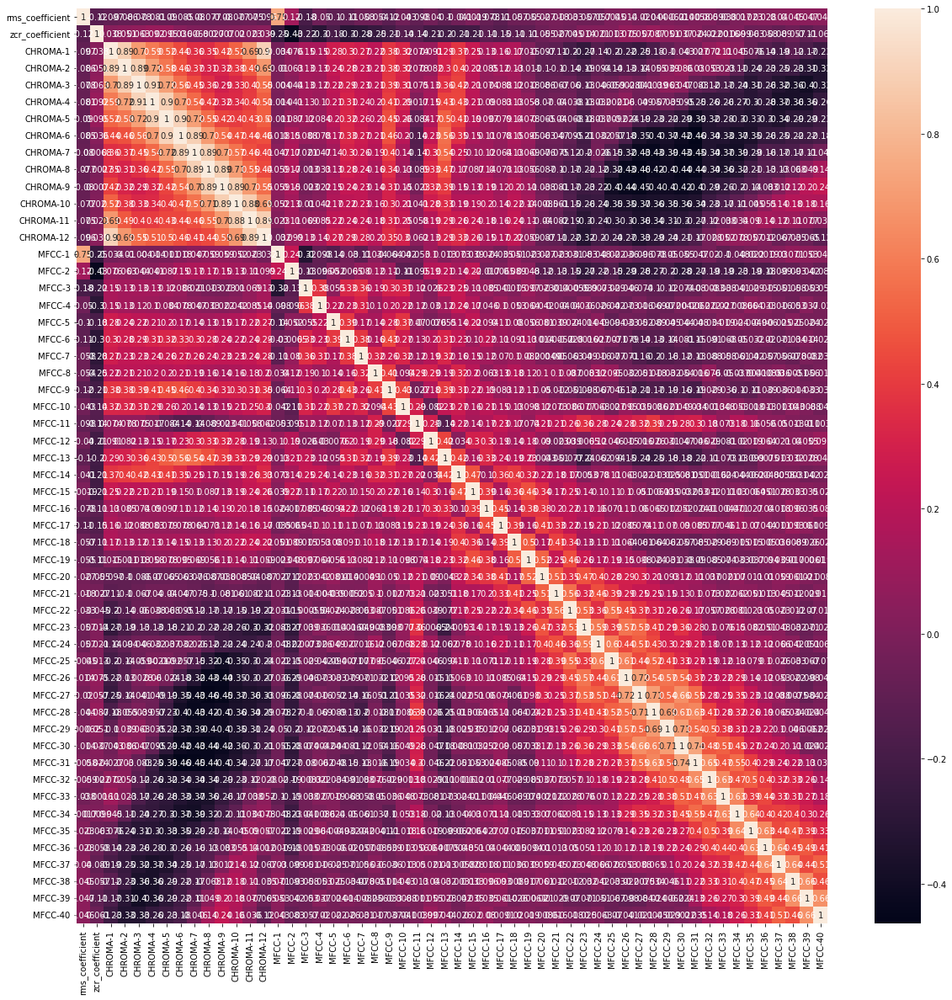

In [20]:
import seaborn as sns
cor = features_df.corr()
plt.figure(figsize=(20,20))
sns.heatmap(cor, annot=True)
plt.show()

###Outliers Analysis

Outliers are the irregularities in the data. Outliers can be identified using mutliple technques. Below visualization of Box-plot uses IQR (Inter-Quartile Range) to identify the outliers in the data.

,rms_coefficient,zcr_coefficient,CHROMA-1,CHROMA-2,CHROMA-3,CHROMA-4,CHROMA-5,CHROMA-6,CHROMA-7,CHROMA-8,CHROMA-9,CHROMA-10,CHROMA-11,CHROMA-12,MFCC-1,MFCC-2,MFCC-3,MFCC-4,MFCC-5,MFCC-6,MFCC-7,MFCC-8,MFCC-9,MFCC-10,MFCC-11,MFCC-12,MFCC-13,MFCC-14,MFCC-15,MFCC-16,MFCC-17,MFCC-18,MFCC-19,MFCC-20,MFCC-21,MFCC-22,MFCC-23,MFCC-24,MFCC-25,MFCC-26,MFCC-27,MFCC-28,MFCC-29,MFCC-30,MFCC-31,MFCC-32,MFCC-33,MFCC-34,MFCC-35,MFCC-36,MFCC-37,MFCC-38,MFCC-39,MFCC-40
file_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
S136_hum_2_Frozen.wav,-0.015303,-0.748443,-0.487114,-0.914961,-1.319826,-1.408833,-1.188141,-0.957488,-0.383733,-0.166599,0.346892,0.274348,0.182050,-0.090604,0.166268,0.053942,0.476690,1.129215,0.580844,-0.645963,-0.594682,-0.287336,0.704941,0.757733,-0.871404,-0.304987,0.975039,0.062211,-0.297224,0.642373,0.375009,-1.515185,-1.721308,0.083292,0.288834,-0.822269,0.023511,-0.030841,-1.359917,-1.251170,-0.961959,-0.571303,0.633466,0.192859,0.027931,2.005339,1.999991,-0.221152,1.042458,2.233006,1.332588,2.418803,2.915402,0.886889
S136_hum_4_Frozen.wav,-0.028050,-0.540335,-0.353502,-0.832988,-0.880549,-0.795133,-0.544774,-0.123234,0.581508,0.786784,1.276155,0.930311,0.794234,0.202198,0.191710,0.692732,-0.160247,1.255728,0.637987,-1.163741,-0.739970,-0.588648,0.485136,0.887738,-1.068207,-0.489609,1.102020,0.390119,0.065196,0.293945,0.170304,-0.884638,-1.404714,0.180488,0.498898,-0.809605,0.093185,-0.083847,-1.134557,-0.512592,-1.051520,-1.381788,0.547898,0.273890,-0.986230,0.386357,1.443461,0.176375,0.653652,1.363201,0.861558,1.557314,2.163217,1.056233
S137_hum_2_Frozen.wav,2.064998,-0.721202,-0.884894,-1.550192,-1.674285,-1.443259,-1.315000,-0.483860,0.126796,-0.092263,0.924455,1.074923,0.477199,-0.323288,1.935828,1.381993,-1.105820,-1.029490,-0.508802,1.314166,0.142193,-1.392377,-1.417521,-0.969580,-0.407899,0.198779,0.111957,0.876737,0.090062,-0.839555,-0.037071,0.157242,0.295822,0.125876,-1.708142,-1.029882,0.173258,-0.693077,-1.804996,-0.099741,-0.363112,-1.624461,-2.039834,-1.149230,1.099581,0.953992,-1.796180,0.363818,0.866428,1.171900,3.163683,2.578400,3.024475,2.318308
S137_hum_4_Frozen.wav,0.889100,-0.696396,-0.509910,-1.184266,-1.526833,-1.274616,-1.242011,-0.624604,-0.375458,0.096892,1.041991,0.889477,0.251264,-0.481039,1.343676,1.025598,-0.155521,-0.479035,-0.288920,0.984832,-0.287529,-0.863283,-0.761458,0.079636,-0.784060,0.284093,0.981457,0.304394,-0.043815,0.447994,-0.118694,0.352811,1.378018,-0.114602,-2.050115,-1.138251,1.111207,-1.432787,-0.924231,0.156158,-0.451303,-1.269532,-1.488364,0.090973,0.448619,1.027260,-0.627245,0.602334,0.273771,0.599036,3.149417,1.926912,3.022309,2.091271
S138_hum_2_Frozen.wav,-0.766289,-0.429465,2.308930,1.872805,1.286567,1.460052,1.556188,2.062649,1.045695,0.338914,0.888226,0.863787,1.646923,1.775623,-0.542856,-0.259289,-0.370152,0.098625,0.742475,0.814748,-0.615908,0.288515,1.769276,1.562722,0.974811,1.066792,1.524081,1.784950,1.051731,1.073094,1.099937,1.325508,0.806849,0.865764,1.206648,0.399087,-0.349913,0.428735,1.557672,1.501756,0.421760,0.669557,1.180900,1.078750,0.622805,1.418399,1.384477,1.333416,0.438785,0.347012,0.882175,0.932809,-0.046862,0.222759
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
S172_hum_2_Panther.wav,-0.615449,0.907920,-0.596382,-0.963612,-0.597228,-0.250485,-0.509104,-0.310108,0.200417,0.930694,0.156273,-0.367813,0.872466,0.289116,-0.287770,-0.128901,-1.748581,-1.326096,0.085769,-0.671527,-1.945412,1.777124,-3.171514,0.335147,0.876083,-2.029865,0.489255,-2.169889,-0.497788,0.785578,-0.940511,0.333054,-0.698338,0.774686,-1.238739,-1.637626,-1.129408,-0.205015,-1.369266,-0.138806,0.802460,0.976466,-0.650536,-0.358864,-0.391518,-2.725717,-0.241284,-0.473647,1.237363,-0.030869,-2.189693,-0.759610,-0.313920,-0.969951
S173_hum_2_Panther.wav,1.687444,0.251707,0.530088,1.107655,1.5555

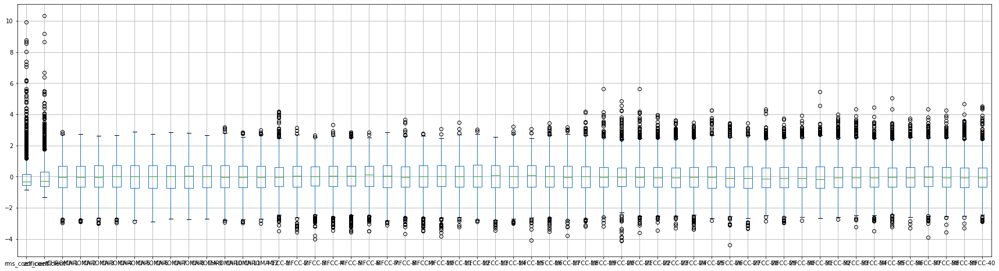

In [21]:
Z = (features_df-features_df.mean())/features_df.std()
display(Z)
Z.boxplot(figsize=(30,8))

In [23]:
print('Number of rows before discarding outliers = %d' % (Z.shape[0]))

Z2 = Z.loc[((Z > -3).sum(axis=1)==54) & ((Z <= 3).sum(axis=1)==54),:]
print('Number of rows after discarding missing values = %d' % (Z2.shape[0]))

Number of rows before discarding outliers = 2342
Number of rows after discarding missing values = 1974


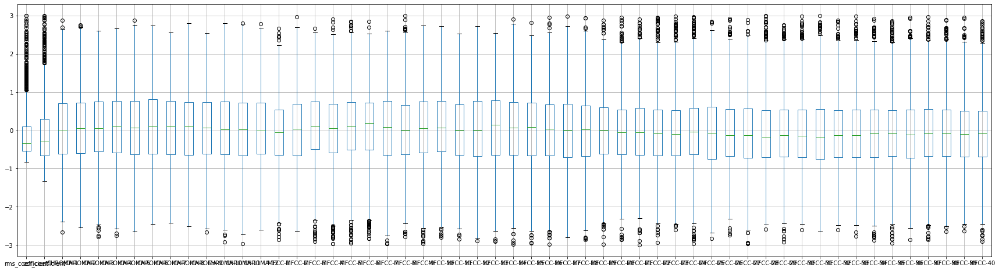

In [24]:
Z2.boxplot(figsize=(30,8))

# 8 Results



##8.1 Model Exploration

As the problem statement is to classify the audio input into 8 different songs based on the audio signal features. We will first select some of the classic Machine learning classification models like Support Vector Machines classifier(SVC), k-Nearest-Neighbout clasifier(kNN), Decision Trees, Random Forest Classifier, Gaussian Naive Bayes, MLPClassifier, etc.

Also, data needs to be scaled because different features have different range of values and thus model can give more weight to the features with higher range. Sklearn library's StandardScaler is used for features with unknown distributions because centering the features at zero-mean with a standard deviation of 1 means extreme values will have less of an impact on the model's learned weights, so that the model is less sensitive to the outliers.

To process these functions, sklearn library's machine learning pipeline is used which automates the above steps.

### Data Split: Training: 80% and Validation : 20%

In order to compare models,we have to evaluate their performance on an unseen data. The simplest method to do so is by training a model on some portion of our dataset and test it on the remainder. Here we have used sklearn's train_test_split function to create a standard 80/20 train/test split. The model is fit on 80% of the data and tested for performance against 20% of the data, which unseen for it in the training. We are calling it as Validation data.



In [25]:
from sklearn.model_selection import train_test_split

#test_size=0.2 defines the 20% test size and rest 80% training size
X_train, X_val, y_train, y_val = train_test_split(features,songs_titles,test_size=0.20,random_state=0)
X_train.shape, X_val.shape, len(y_train), len(y_val)

((1873, 54), (469, 54), 1873, 469)

### Comparing Models

In [26]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.neural_network import MLPClassifier
from sklearn.pipeline import Pipeline

classification_models = [
                         KNeighborsClassifier(n_neighbors=5),
                         SVC(kernel = "linear" ,C=1),
                         SVC(kernel='rbf', C=1),
                         GaussianNB(),
                         LogisticRegression(),
                         DecisionTreeClassifier(),
                         RandomForestClassifier(n_estimators=500),
                         AdaBoostClassifier(),
                         MLPClassifier(random_state = 69, hidden_layer_sizes=(512,))
                         ]

model_scores = []
for model in classification_models:
  # Pipeline object is created to perform model training and evaluate the performance of each model.
  model_pipeline = Pipeline([('scaler', StandardScaler()), ('model_training', model)])
  model_pipeline.fit(X_train, y_train)

  model_name = type(model).__name__
  if model_name=='SVC' and model.kernel=='rbf': 
    model_name+='RBF kernel'
  
  model_scores.append((model_name,(f'{100*model_pipeline.score(X_val, y_val):.2f}%')))

# Create the dataframe for score of each model
df_model_scores = pd.DataFrame(model_scores,columns=['Classification Model','Accuracy Score'])
df_model_scores.sort_values(by='Accuracy Score',axis=0,ascending=False)



/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


,Classification Model,Accuracy Score
6,RandomForestClassifier,49.47%
8,MLPClassifier,45.63%
2,SVCRBF kernel,43.50%
1,SVC,37.95%
4,LogisticRegression,37.10%
3,GaussianNB,31.98%
5,DecisionTreeClassifier,28.57%
7,AdaBoostClassifier,28.14%
0,KNeighborsClassifier,22.81%


## 8.2 Model Training and Evaluation: 

We will pick the top three models - Random Forests, MLPClassifier and SVCRBFKernel and further analyze them.



### 8.2.1 Support Vector Machines classifier(SVC)

Support Vectors Classifier tries to find the best hyperplane to separate the different classes by maximizing the distance between sample points and the hyperplane. We are analyzing SVC RBF, kernel parameters selects the type of hyperplane used to separate the data.



####Model Pipeline

SVC Model pipeline includes StandardScaler function to normalize the data and SVC kernel = rbf 

In [28]:
from sklearn.svm import SVC
from sklearn.preprocessing import StandardScaler
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline

X_train, X_val, y_train, y_val = train_test_split(features,songs_titles,test_size=0.20,random_state=0)

pipeline_svc = Pipeline([('scaler', StandardScaler()), ('svc', SVC(kernel="rbf", C=1.0))])
pipeline_svc.fit(X_train, y_train)

svc_y_train_pred = pipeline_svc.predict(X_train)
svc_y_val_pred = pipeline_svc.predict(X_val)


print("Training Accuracy for SVC pipeline: {}".format(pipeline_svc.score(X_train, y_train)))
print("Validation Accuracy for SVC pipeline: {}".format(pipeline_svc.score(X_val, y_val)))

Training Accuracy for SVC pipeline: 0.6577682861719167
Validation Accuracy for SVC pipeline: 0.4349680170575693


#### Confusion Matrix

Confusion matrix below gives the True Positives for each class on the diagonal. We can observe that the model is most confused between (Showman & StarWars), (Potter and Frozen) with least True positives for class Showman. 

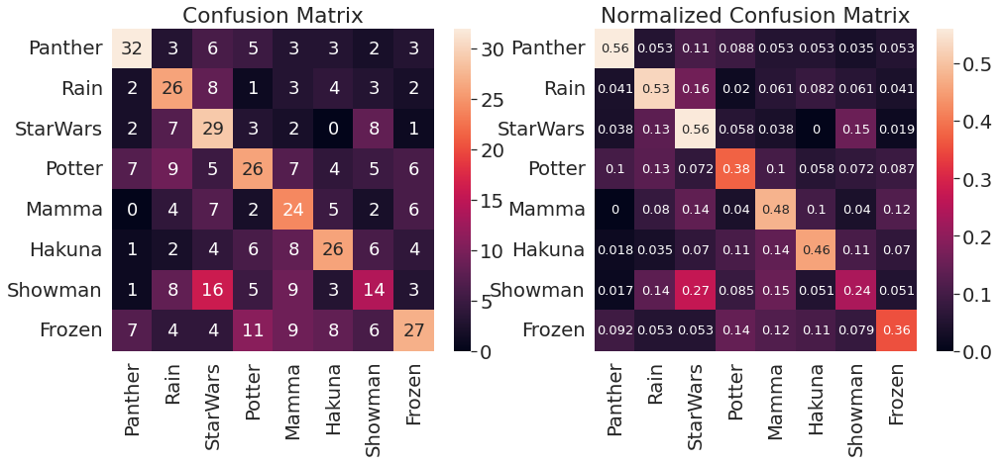

In [29]:
from sklearn.metrics import confusion_matrix
import seaborn as sn # I like seaborn's confusion matrix over sklearn's default

# get predictions on test set 
test_song_predictions = svc_y_val_pred
test_songs_groundtruth = y_val

# build confusion matrix and normalized confusion matrix
conf_matrix = confusion_matrix(test_songs_groundtruth, test_song_predictions)
conf_matrix_norm = confusion_matrix(test_songs_groundtruth, test_song_predictions,normalize='true')

# set labels for matrix axes from Songs list
song_list = ['Panther','Rain', 'StarWars','Potter','Mamma','Hakuna','Showman','Frozen']
song_name = [song for song in song_list]

# make a confusion matrix with labels using a DataFrame
confmatrix_df = pd.DataFrame(conf_matrix, index=song_name, columns=song_name)
confmatrix_df_norm = pd.DataFrame(conf_matrix_norm, index=song_name, columns=song_name)

# plot confusion matrices
plt.figure(figsize=(16,6))
sn.set(font_scale=1.8) # emotion label and title size
plt.subplot(1,2,1)
plt.title('Confusion Matrix')
sn.heatmap(confmatrix_df, annot=True, annot_kws={"size": 18}) #annot_kws is value font
plt.subplot(1,2,2)
plt.title('Normalized Confusion Matrix')
sn.heatmap(confmatrix_df_norm, annot=True, annot_kws={"size": 13}) #annot_kws is value font

plt.show()

####Classification Report
Below Classification matrix shows that precision value is best for Frozen whereas it worse in the case of Showman.
Also, Overall accuracy recorded is 43 percent which is very good as per the data quality.


In [30]:
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import classification_report

# Output the classification report for SVC
print(classification_report(y_val, svc_y_val_pred, zero_division=0))
print(precision_recall_fscore_support(y_val, svc_y_val_pred, average='macro',zero_division=0))

              precision    recall  f1-score   support

      Frozen       0.62      0.56      0.59        57
      Hakuna       0.41      0.53      0.46        49
       Mamma       0.37      0.56      0.44        52
     Panther       0.44      0.38      0.41        69
      Potter       0.37      0.48      0.42        50
        Rain       0.49      0.46      0.47        57
     Showman       0.30      0.24      0.27        59
    StarWars       0.52      0.36      0.42        76

    accuracy                           0.43       469
   macro avg       0.44      0.44      0.43       469
weighted avg       0.44      0.43      0.43       469

(0.4399031255080005, 0.44440141249128073, 0.4348875016166607, None)


####Hyperparameters Tuning

Hyperparameter optimization or tuning is the problem of choosing a set of optimal hyperparameters for a learning algorithm. It calculates the measure of optimization for each combination of values provided in the param grid.

From the below GridSearchCV for SVC, best parameters identified are C:1000, gamma = 0.001. In this scenario, there is marginal difference observed in precision and recall values using the above parameters.

Overall, the accuracy and f1-score is similar as above and thus no further improvmement is observed.

In [33]:
from sklearn.model_selection import GridSearchCV

# Now that we know standard scaling is best for our features, we'll use those for our training and test sets
X_train, X_val, y_train, y_val = train_test_split(features,songs_titles,test_size=0.20,random_state=0)

# Initialize the SVC Classifier and choose parameters we want to keep constant
#svc_model = SVC()

pipeline_svc = Pipeline([('scaler', StandardScaler()), ('svc', SVC(kernel="rbf", C=1.0))])

# Choose the grid of hyperparameters we want to use for Grid Search to build our candidate models
svc_param_grid = {'svc__C': [1, 10, 100, 1000], 'svc__gamma': [0.001, 0.0001], 'svc__kernel': ['rbf']}
   
# Create a grid search object which will store the scores and hyperparameters of all candidate models 
svc_grid = GridSearchCV(
    estimator = pipeline_svc, 
    param_grid=svc_param_grid,
    cv=5)
# Fit the models specified by the parameter grid 
svc_grid.fit(X_train, y_train)

# get the best hyperparameters from grid search object with its best_params_ attribute
print('Best parameters found:\n', svc_grid.best_params_)

print(svc_grid.best_score_)
svc_grid_predict = svc_grid.predict(X_val)
print(confusion_matrix(y_val,svc_grid_predict))
print(classification_report(y_val,svc_grid_predict))

Best parameters found:
 {'svc__C': 1000, 'svc__gamma': 0.001, 'svc__kernel': 'rbf'}
0.4009682709447415
[[30  3  6  5  6  4  1  2]
 [ 3 26  4  1  2  4  4  5]
 [ 5  4 31  5  2  1  3  1]
 [ 9  6  4 25  9  4  2 10]
 [ 7  3  5  4 20  6  2  3]
 [ 3  4  2  6 11 25  4  2]
 [ 5  5 14  5  8  3 14  5]
 [10  5  4 12  7  8  4 26]]
              precision    recall  f1-score   support

      Frozen       0.42      0.53      0.47        57
      Hakuna       0.46      0.53      0.50        49
       Mamma       0.44      0.60      0.51        52
     Panther       0.40      0.36      0.38        69
      Potter       0.31      0.40      0.35        50
        Rain       0.45      0.44      0.45        57
     Showman       0.41      0.24      0.30        59
    StarWars       0.48      0.34      0.40        76

    accuracy                           0.42       469
   macro avg       0.42      0.43      0.42       469
weighted avg       0.42      0.42      0.41       469



### 8.2.3 RandomForestClassifier

Random forest is an extension of bagging, but taking one extra step. Along with taking the random subset of data, it also takes the random selection of features rather than using all features to grow trees. When you have many decision trees, it becomes a random forest.

By allowing each tree to randomly sample from the dataset with replacement we get different trees since decision trees are sensitive to data they are trained on.

Random Forests are excellent models to use as a benchmark due to their low time complexity to train and because it is an ensemble method, their robustness to unknown distributions and outliers in the dataset, meaning Random Forests require relatively little exploratory analysis in both the data and training the model to get an idea of their performance in a task.

####Model Pipeline

RandomForest piepline is created using the Standard Scaler and RandomForestClassifier. Model is trained on the scaled input data before using it for prediction on validation data.

In [34]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline

X_train, X_val, y_train, y_val = train_test_split(features,songs_titles,test_size=0.20,random_state=0)

pipeline_rfc = Pipeline([('scaler', StandardScaler()), ('rfc', RandomForestClassifier())])
pipeline_rfc.fit(X_train, y_train)

rfc_y_train_pred = pipeline_rfc.predict(X_train)
rfc_y_val_pred = pipeline_rfc.predict(X_val)

print("Training Accuracy for RandomForestClassifier pipeline: {}".format(pipeline_rfc.score(X_train, y_train)))
print("Validation Accuracy for RandomForestClassifier pipeline: {}".format(pipeline_rfc.score(X_val, y_val)))

Training Accuracy for RandomForestClassifier pipeline: 1.0
Validation Accuracy for RandomForestClassifier pipeline: 0.44349680170575695


####Confusion Matrix

Confusion matrix generated by the RandomForestClassifier model depicts that the True Positives (Values Identified correctly that they belong to a particular class) and True Negatives (Values Identified correctly that they do not belong to a particular class) have slightly improved for some classes and decreased for others as compared to SVC. Most confused classes for SVC (Showman and Starwars) accuracy have improved whereas Hakuna and Mamma classes are more confued with Frozen.

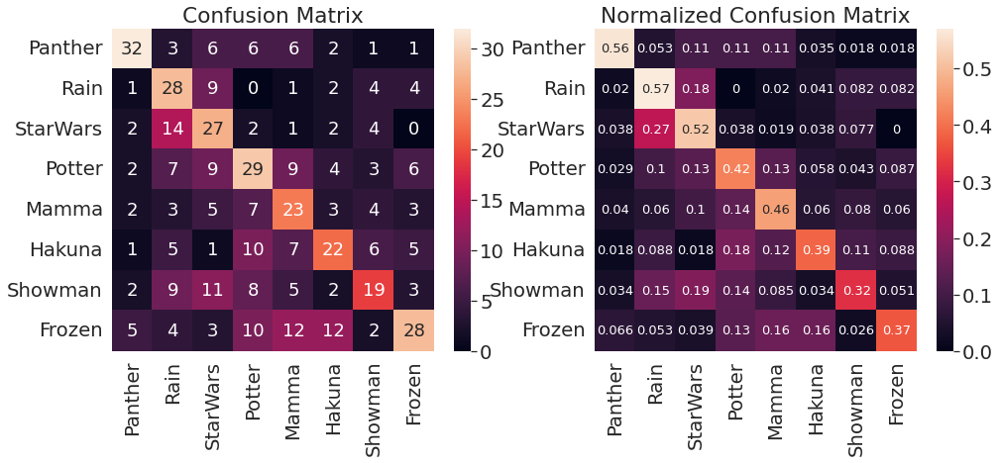

In [36]:
from sklearn.metrics import confusion_matrix
import seaborn as sn # I like seaborn's confusion matrix over sklearn's default

# get predictions on test set 
test_song_predictions = rfc_y_val_pred
test_songs_groundtruth = y_val

# build confusion matrix and normalized confusion matrix
conf_matrix = confusion_matrix(test_songs_groundtruth, test_song_predictions)
conf_matrix_norm = confusion_matrix(test_songs_groundtruth, test_song_predictions,normalize='true')

# set labels for matrix axes from Songs list
song_list =['Panther','Rain', 'StarWars','Potter','Mamma','Hakuna','Showman','Frozen']
song_name = [song for song in song_list]

# make a confusion matrix with labels using a DataFrame
confmatrix_df = pd.DataFrame(conf_matrix, index=song_name, columns=song_name)
confmatrix_df_norm = pd.DataFrame(conf_matrix_norm, index=song_name, columns=song_name)

# plot confusion matrices
plt.figure(figsize=(16,6))
sn.set(font_scale=1.8) # emotion label and title size
plt.subplot(1,2,1)
plt.title('Confusion Matrix')
sn.heatmap(confmatrix_df, annot=True, annot_kws={"size": 18}) #annot_kws is value font
plt.subplot(1,2,2)
plt.title('Normalized Confusion Matrix')
sn.heatmap(confmatrix_df_norm, annot=True, annot_kws={"size": 13}) #annot_kws is value font

plt.show()

####Classification Report

Overall f-1 score and accuracy have marginally increased in RandomForest as compared to the SVC Model

In [37]:
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import classification_report

# Output the classification report for RFC
print(classification_report(y_val, rfc_y_val_pred, zero_division=0))
print(precision_recall_fscore_support(y_val, rfc_y_val_pred, average='macro',zero_division=0))

              precision    recall  f1-score   support

      Frozen       0.68      0.56      0.62        57
      Hakuna       0.38      0.57      0.46        49
       Mamma       0.38      0.52      0.44        52
     Panther       0.40      0.42      0.41        69
      Potter       0.36      0.46      0.40        50
        Rain       0.45      0.39      0.42        57
     Showman       0.44      0.32      0.37        59
    StarWars       0.56      0.37      0.44        76

    accuracy                           0.44       469
   macro avg       0.46      0.45      0.45       469
weighted avg       0.46      0.44      0.44       469

(0.45721090406713005, 0.45109657096513744, 0.44504618655079886, None)


####Hyperparamter Tuning

On optimizing the parameters value for RandomForestClassifier using GridSearchSV, Overall accuracy achieved is 42% which is slightly less than the original value of 44%.

In [39]:
from sklearn.model_selection import GridSearchCV

# Now that we know standard scaling is best for our features, we'll use those for our training and test sets
X_train, X_val, y_train, y_val = train_test_split(features,songs_titles,test_size=0.20,random_state=0)

# Initialize the RFC Classifier and choose parameters we want to keep constant
pipeline_rfc = Pipeline([('scaler', StandardScaler()), ('rfc', RandomForestClassifier())])

# Choose the grid of hyperparameters we want to use for Grid Search to build our candidate models
rfc_param_grid={
    'rfc__n_estimators': [200, 500, 800],
    'rfc__max_features': ['auto', 'sqrt', 'log2'],
    'rfc__max_depth': [4, 5, 6, 7, 8],
    'rfc__criterion': ['gini', 'entropy']}
   
# Create a grid search object which will store the scores and hyperparameters of all candidate models 
rfc_param_grid = GridSearchCV(
    estimator=pipeline_rfc, 
    param_grid=rfc_param_grid,
    cv=5
    )
# Fit the models specified by the parameter grid 
rfc_param_grid.fit(X_train, y_train)

# get the best hyperparameters from grid search object with its best_params_ attribute
print('Best parameters found:\n', rfc_param_grid.best_params_)

print(rfc_param_grid.best_score_)
rfc_grid_predict = rfc_param_grid.predict(X_val)
print(confusion_matrix(y_val,rfc_grid_predict))
print(classification_report(y_val,rfc_grid_predict))

Best parameters found:
 {'rfc__criterion': 'entropy', 'rfc__max_depth': 8, 'rfc__max_features': 'log2', 'rfc__n_estimators': 500}
0.41058110516934043
[[34  3  5  7  2  2  4  0]
 [ 3 30 10  0  0  2  4  0]
 [ 1 13 26  3  2  1  6  0]
 [ 3  7 11 26  9  4  4  5]
 [ 2  5  6  5 23  2  5  2]
 [ 3  8  5  5  6 24  4  2]
 [ 2  9 14  6  5  6 17  0]
 [ 6  4  9 10  9 14  6 18]]
              precision    recall  f1-score   support

      Frozen       0.63      0.60      0.61        57
      Hakuna       0.38      0.61      0.47        49
       Mamma       0.30      0.50      0.38        52
     Panther       0.42      0.38      0.40        69
      Potter       0.41      0.46      0.43        50
        Rain       0.44      0.42      0.43        57
     Showman       0.34      0.29      0.31        59
    StarWars       0.67      0.24      0.35        76

    accuracy                           0.42       469
   macro avg       0.45      0.44      0.42       469
weighted avg       0.46      0.42    

### 8.2.3 MLP Model for Classification
We can also test the Multilayer Perceptron (MLP) Classifier, a simple artificial neural network (ANN) model well-suited for predictions trained on labelled inputs. Note that an MLP model can be trained for regression just as well. An MLP network consists of an input layer, n hidden layers, and an output layer.

####Model Pipeline

We initialize an MLP classification model with random weights and biases at zero, the standard modality. There are techniques for determining optimal weight initialization; the initial distribution of weights is incrediby important because they impact the direction of the gradient and will determine how fast and whether at all a model's loss function will converge.

In [41]:
from sklearn.neural_network import MLPClassifier
from sklearn.preprocessing import LabelEncoder

encoder = LabelEncoder()
songs_titles_encoded = encoder.fit_transform(songs_titles)

X_train, X_val, y_train, y_val = train_test_split(features,songs_titles_encoded,test_size=0.20,random_state=0)

# Default MLP from sklearn
mlp_model = MLPClassifier(random_state = 69)
mlp_model.fit(X_train, y_train)

print(f'Possible song predicted by model:{mlp_model.classes_}')
print(f'Unscaled MLP Model\'s accuracy on training set is {100*mlp_model.score(X_train, y_train):.2f}%')
print(f'Unscaled MLP Model\'s accuracy on test set is {100*mlp_model.score(X_val, y_val):.2f}%')


X_train, X_val, y_train, y_val = train_test_split(features,songs_titles_encoded,test_size=0.20,random_state=0)
pipeline_mlp = Pipeline([('scaler', StandardScaler()), ('mlp', MLPClassifier(random_state = 69))])

pipeline_mlp.fit(X_train, y_train)

mlp_y_train_pred = pipeline_mlp.predict(X_train)
mlp_y_val_pred = pipeline_mlp.predict(X_val)

print(f'Scaled MLP Model\'s accuracy on training set is {100*pipeline_mlp.score(X_train, y_train):.2f}%')
print(f'Scaled MLP Model\'s accuracy on test set is {100*pipeline_mlp.score(X_val, y_val):.2f}%')

Possible song predicted by model:[0 1 2 3 4 5 6 7]
Unscaled MLP Model's accuracy on training set is 37.91%
Unscaled MLP Model's accuracy on test set is 27.51%
Scaled MLP Model's accuracy on training set is 89.80%
Scaled MLP Model's accuracy on test set is 41.58%


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


Fitting the MLPClassifier with increased size of the hidden layers to 512

In [15]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.neural_network import MLPClassifier
from sklearn.preprocessing import LabelEncoder
encoder = LabelEncoder()
songs_titles_encoded = encoder.fit_transform(songs_titles)

X_train, X_val, y_train, y_val = train_test_split(features_df,songs_titles_encoded,test_size=0.20,random_state=0)
pipeline_mlp = Pipeline([('scaler', StandardScaler()), ('mlp', MLPClassifier(activation='logistic', alpha= 0.001, solver='adam', epsilon=1e-08, hidden_layer_sizes=(512,), 
                                               learning_rate='adaptive',max_iter=500))])

pipeline_mlp.fit(X_train, y_train)

mlp_y_train_pred = pipeline_mlp.predict(X_train)
mlp_y_val_pred = pipeline_mlp.predict(X_val)

print(f'Scaled MLP Model\'s accuracy on training set is {100*pipeline_mlp.score(X_train, y_train):.2f}%')
print(f'Scaled MLP Model\'s accuracy on test set is {100*pipeline_mlp.score(X_val, y_val):.2f}%')

Scaled MLP Model's accuracy on training set is 98.67%
Scaled MLP Model's accuracy on test set is 46.48%


/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


####Confusion Matrix

Grid search chose the logistic sigmoid function as the best activation function, suited to binary classification. Our two classes Potter and StarWars precision and recall values have increased and in the similar range as Logistic Regression classifier.

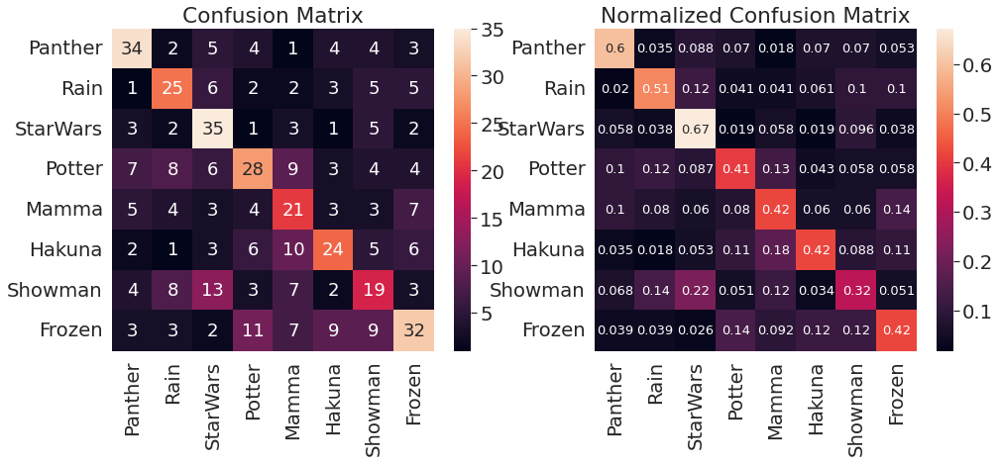

In [16]:
from sklearn.metrics import confusion_matrix
import seaborn as sn # I like seaborn's confusion matrix over sklearn's default

# get predictions on test set 
test_song_predictions = mlp_y_val_pred
test_songs_groundtruth = y_val

# build confusion matrix and normalized confusion matrix
conf_matrix = confusion_matrix(test_songs_groundtruth, test_song_predictions)
conf_matrix_norm = confusion_matrix(test_songs_groundtruth, test_song_predictions,normalize='true')

song_list =['Panther','Rain', 'StarWars','Potter','Mamma','Hakuna','Showman','Frozen']
song_name = [song for song in song_list]

# make a confusion matrix with labels using a DataFrame
confmatrix_df = pd.DataFrame(conf_matrix, index=song_name, columns=song_name)
confmatrix_df_norm = pd.DataFrame(conf_matrix_norm, index=song_name, columns=song_name)

# plot confusion matrices
plt.figure(figsize=(16,6))
sn.set(font_scale=1.8) # emotion label and title size
plt.subplot(1,2,1)
plt.title('Confusion Matrix')
sn.heatmap(confmatrix_df, annot=True, annot_kws={"size": 18}) #annot_kws is value font
plt.subplot(1,2,2)
plt.title('Normalized Confusion Matrix')
sn.heatmap(confmatrix_df_norm, annot=True, annot_kws={"size": 13}) #annot_kws is value font

plt.show()

####Classification Matrix

Below classification matrix for MLPClassifier depicts that the precision and recall values as well as overall accuracy of the model are very similar to the logistic regression classifier. It confirms the logistic behaviour of the model as the activation function which gives the maximum accuracy for MLPClassifier is also logistic.

In [17]:
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import classification_report

# Output the classification report for RFC
print(classification_report(y_val, mlp_y_val_pred, zero_division=0))
print(precision_recall_fscore_support(y_val, mlp_y_val_pred, average='macro',zero_division=0))

              precision    recall  f1-score   support

           0       0.58      0.60      0.59        57
           1       0.47      0.51      0.49        49
           2       0.48      0.67      0.56        52
           3       0.47      0.41      0.44        69
           4       0.35      0.42      0.38        50
           5       0.49      0.42      0.45        57
           6       0.35      0.32      0.34        59
           7       0.52      0.42      0.46        76

    accuracy                           0.46       469
   macro avg       0.46      0.47      0.46       469
weighted avg       0.47      0.46      0.46       469

(0.46372180351330616, 0.47121356196150077, 0.4635753309079076, None)


### 8.2.4 Convolutional Neural Networks

A Convolutional Neural Network (ConvNet/CNN) is a Deep Learning algorithm which can take in an input image, assign importance (learnable weights and biases) to various aspects/objects in the image and be able to differentiate one from the other.


Here input is the audio signal which needs to be classified as one of the 8 songs.

In [18]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense,Dropout,Activation,Flatten
from tensorflow.keras.optimizers import Adam
from sklearn import metrics

In [26]:
from sklearn.preprocessing import LabelEncoder
encoder = LabelEncoder()
songs_titles_encoded = encoder.fit_transform(songs_titles)

### Label Encoding
y=np.array(pd.get_dummies(songs_titles_encoded))

X_train, X_val, y_train, y_val = train_test_split(features_df,y,test_size=0.20,random_state=0)
X_train.shape, X_val.shape, y_train.shape, y_val.shape

num_labels=y.shape[1]
num_labels

8

In [27]:
model=Sequential()
###first layer
model.add(Dense(100,input_shape=(54,)))
model.add(Activation('relu'))
model.add(Dropout(0.5))
###second layer
model.add(Dense(200))
model.add(Activation('relu'))
model.add(Dropout(0.5))
###third layer
model.add(Dense(100))
model.add(Activation('relu'))
model.add(Dropout(0.5))

###final layer
model.add(Dense(num_labels))
model.add(Activation('softmax'))

In [28]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_4 (Dense)             (None, 100)               5500      
                                                                 
 activation_4 (Activation)   (None, 100)               0         
                                                                 
 dropout_3 (Dropout)         (None, 100)               0         
                                                                 
 dense_5 (Dense)             (None, 200)               20200     
                                                                 
 activation_5 (Activation)   (None, 200)               0         
                                                                 
 dropout_4 (Dropout)         (None, 200)               0         
                                                                 
 dense_6 (Dense)             (None, 100)              

In [29]:
model.compile(loss='categorical_crossentropy',metrics=['accuracy'],optimizer='adam')

In [32]:
## Trianing my model
from tensorflow.keras.callbacks import ModelCheckpoint
from datetime import datetime 

num_epochs = 100
num_batch_size = 128

checkpointer = ModelCheckpoint(filepath='/content/drive/MyDrive/Data/MLEndHW/MLEndHumandWhistle.hdf5', 
                               verbose=1, save_best_only=True)
start = datetime.now()

model.fit(X_train, y_train, batch_size=num_batch_size, epochs=num_epochs, validation_data=(X_val, y_val), callbacks=[checkpointer], verbose=1)


duration = datetime.now() - start
print("Training completed in time: ", duration)

Epoch 1/100
15/15 [==============================] - ETA: 0s - loss: 2.0796 - accuracy: 0.1303
Epoch 00001: val_loss improved from inf to 2.08485, saving model to /content/drive/MyDrive/Data/MLEndHW/MLEndHumandWhistle.hdf5
15/15 [==============================] - 0s 32ms/step - loss: 2.0796 - accuracy: 0.1303 - val_loss: 2.0848 - val_accuracy: 0.1045
Epoch 2/100
15/15 [==============================] - ETA: 0s - loss: 2.0800 - accuracy: 0.1308
Epoch 00002: val_loss improved from 2.08485 to 2.08413, saving model to /content/drive/MyDrive/Data/MLEndHW/MLEndHumandWhistle.hdf5
15/15 [==============================] - 0s 9ms/step - loss: 2.0800 - accuracy: 0.1308 - val_loss: 2.0841 - val_accuracy: 0.1045
Epoch 3/100
14/15 [===========================>..] - ETA: 0s - loss: 2.0773 - accuracy: 0.1311
Epoch 00003: val_loss improved from 2.08413 to 2.08411, saving model to /content/drive/MyDrive/Data/MLEndHW/MLEndHumandWhistle.hdf5
15/15 [==============================] - 0s 10ms/step - loss: 2.

In [33]:
test_accuracy=model.evaluate(X_val,y_val,verbose=0)
print(test_accuracy[1])

0.10447761416435242


In [36]:
y_val_pred = model.predict(X_val)

In [34]:
test_loss, test_acc = model.evaluate(X_val, y_val, batch_size=128)
print("The test Loss is: ", test_loss)
print("The best test accuracy is :", test_acc)

4/4 [==============================] - 0s 3ms/step - loss: 2.0845 - accuracy: 0.1045
The test Loss is:  2.0844717025756836
The best test accuracy is : 0.10447761416435242


# 9 Conclusions

To conclude the advanced solution of MLEnd Hums and Whistle, We have attempted to classify the Hums audio files to one of the 8 songs. Multiple features from the audio signals were extracted to identify the audio signals accurately. These features were fed to the machine learning classification models with the labelled classes in the training dataset. Performance was evaluated based on precision, recall, f-score and overall accuracy on the unseen data (validation data). 

RandomForestClassifier and MLPClassifier worked best in classifying audio files to their actual songs. We have achieved an Overall accuracy of "44%" and 46% respectively in this process. The low accuracy of the model is due to the bad quality of audio files, many of the hums are not recognizable manually and do not follow the same pitch/timeframe of the audio.

Feature extraction and scaling is the most important part of the machine learning piepline and thus needs more in-depth research.

Further noise reduction, frameshifting from the audio files can help in better classifying the songs. Also, Outliers have been identified during the process and can be rejected to further analyze the performance of the model.

# Failed attempts

####Tried PCA for the features and plotted the graph to understand the outliers.

In [ ]:
!pip install 'umap-learn==0.3.10'
import umap.umap_ as umap
from sklearn.preprocessing import StandardScaler
reducer = umap.UMAP()

features_data = features_df.drop('class', axis=1).values
features_scaled_data = StandardScaler().fit_transform(features_data)

embedding = reducer.fit_transform(features_scaled_data)
embedding.shape

(500, 2)

Text(0.5, 1.0, 'UMAP projection of the Songs dataset')

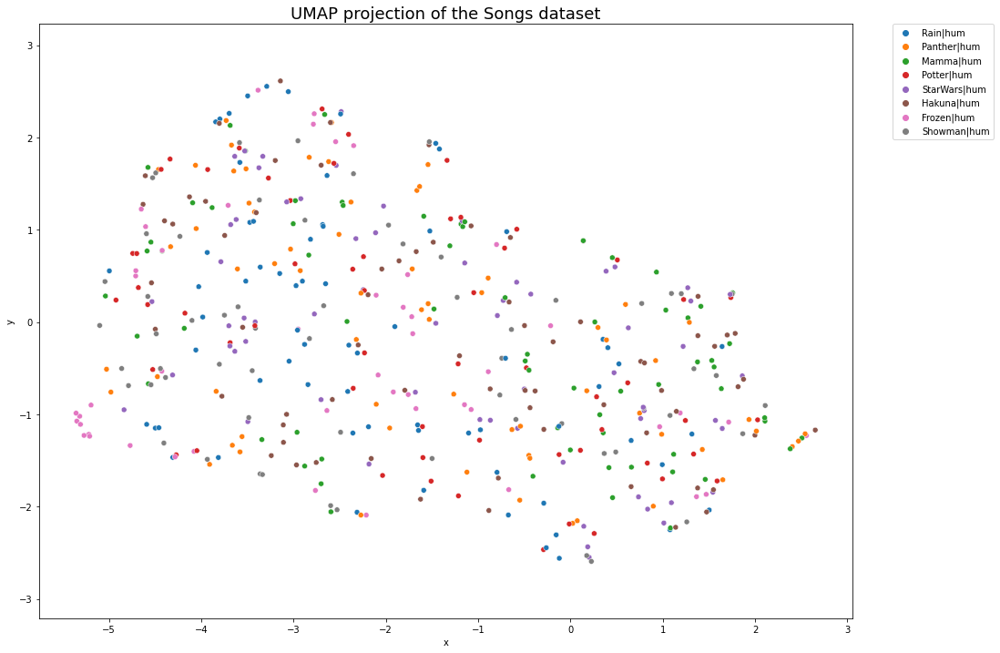

In [ ]:
plt.figure(figsize=(16, 12))
df_projection = pd.DataFrame({'x': embedding[:, 0], 'y': embedding[:, 1],
                              'song': songs_titles})

sns.scatterplot(x='x', y='y', hue='song', data=df_projection)

plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.gca().set_aspect('equal', 'datalim')
plt.title('UMAP projection of the Songs dataset', fontsize=18)

#### Took random sample and tried to reduce noise from the audio.

Seems like a heavy process which crashed the google colab notebook multiple times.

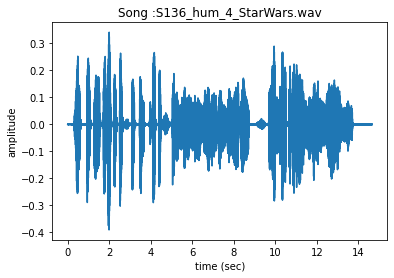

In [ ]:
n = np.random.randint(len(files))
fs = None # Sampling frequency. If None, fs would be 44100
x, fs = librosa.load(files[n],sr=fs)
t = np.arange(len(x))/fs
plt.plot(t,x)
plt.xlabel('time (sec)')
plt.ylabel('amplitude')
plt.title("Song :"+ str(os.path.basename(files[n])))
plt.show()
display(ipd.Audio(files[n]))

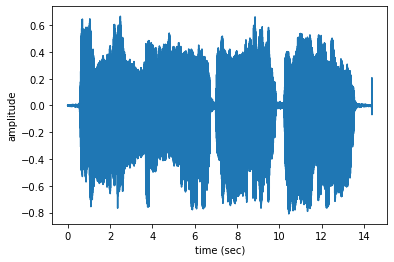

28.750657596371884 28.750657596371884


In [ ]:
# #!pip install noisereduce
# import noisereduce as nr
# from scipy.io import wavfile
# # load data
# rate, data = wavfile.read(files[0])
# # perform noise reduction
# reduced_noise = nr.reduce_noise(y=data, sr=rate)

x_new, index = librosa.effects.trim(x)

t = np.arange(len(x_new))/fs
plt.plot(t,x_new)
plt.xlabel('time (sec)')
plt.ylabel('amplitude')
plt.show()

print(librosa.get_duration(x), librosa.get_duration(x_new))

####Tried to extract more features and decompose the audio signals/


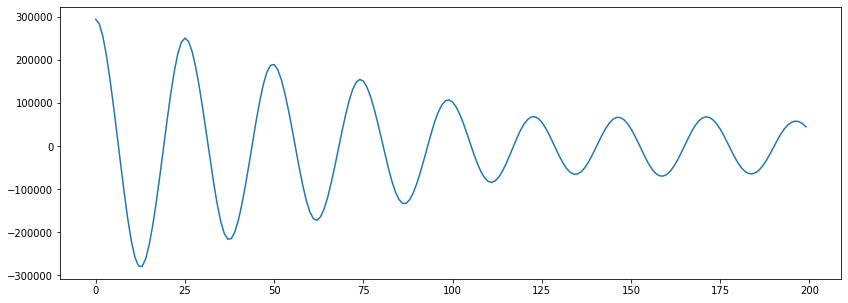

In [ ]:
r = librosa.autocorrelate(waveform)
r

In [ ]:

tempo, beat_times = librosa.beat.beat_track(waveform, sr=sample_rate, start_bpm=60, units='time')
print(tempo)
print(beat_times)

58.72691761363637
[ 0.56888889  1.68344671  2.56580499  3.44816327  4.28408163  5.15482993
  6.16489796  7.18657596  8.12698413  9.07900227  9.92653061 10.83210884
 11.85378685 12.77097506 13.7229932  14.73306122 15.83600907 16.77641723
 17.80970522 18.80816327]


(-1.0, 1.0)

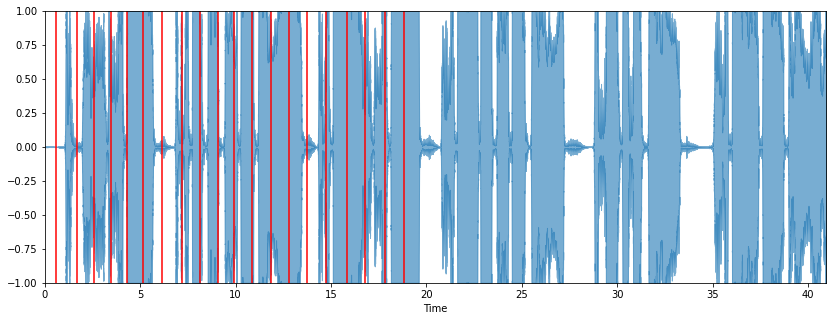

In [ ]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(waveform, alpha=0.6)
plt.vlines(beat_times, -1, 1, color='r')
plt.ylim(-1, 1)